# Master File

This notebook runs the GP backtest, NN-IV training and backtesting, SSVI backtesting and trinomial tree backtesting. Finally all results are compared.

#### Help on Importing files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from the "code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use the neural network while avoiding the training step.
- csv files in "Results" folder if you want to load Results presented in our paper.


In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
from IPython.display import display
import sklearn as skl

import sys
formerPath = sys.path
sys.path.append('./code/')
sys.path.append('./BS/')

import os
formerStdOut = sys.stdout

import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import SSVIFerhati
import neuralNetwork
import experiments


import importlib
plt.rcParams['figure.dpi'] = 50

In [2]:
sys.stdout = formerStdOut

# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

#### Load preformatted data ("Reload")

You should execute that cell, if you want to keep the same training set and testing set as those used in the paper.

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

#### DAX Data ("DAX")

For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.
- "8_8_2001__filterdax.dat" for tikohnov local volatility.

#### From DAX data from .dat files ("DAX dat files")
For a day x you must load :
- "x.dat.modelparam.dat"
- "x.dat.impliedvol.dat"
- "x.dat.calibr.out.dat"
- "x.dat"

#### SPX Data ("SPX")

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

####  Eurostoxx data ("Eurostoxx")

File required : Data_EuroStoxx50_20190110_all_for_Marc.xlsx

# Formatting data

### Boostsrapping Rate Curve

We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [3]:
data = experiments.loadAndFormatData("Reload")
dataSet, dataSetTest, S0, bootstrap, KMin, KMax, midS0, scaler, scaledDataSet, scaledDataSetTest, volLocaleGridDf = data

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


# Neural Network

# Learning Implied volatility
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [4]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0.0#0.1#0.11#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 0.0#100.0#1.0#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 0.0#10000.0#10.0#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.0001#0.01
hyperparameters["lowerBoundGamma"] = 0.0#0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 0.70

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 200
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = True
hyperparameters["nbEpochFork"] = 0#10000
hyperparameters["lambdaFork"] = 0.0#1000.0
hyperparameters["HolderExponent"] =  4.0

Training w.r.t. implied vol RMSE and arbitrage constraints
Iteration :  2125 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 2126): -4.12
Best Penalization :  [0.016319046, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  2132 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 2133): -4.12
Best Penalization :  [0.016319046, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  2139 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 2140): -4.12
Best Penalization :  [0.016319046, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  2146 new learning rate :  1.0000000000000002e-06
Best loss (hidden nodes: 100, iterations: 2147): -4.12
Best Penalization :  [0.016319046, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  2153 new learning rate :  1.0000000000000002e-07
Best loss (hidden nodes: 100, iterations: 2154): -4.12
Be

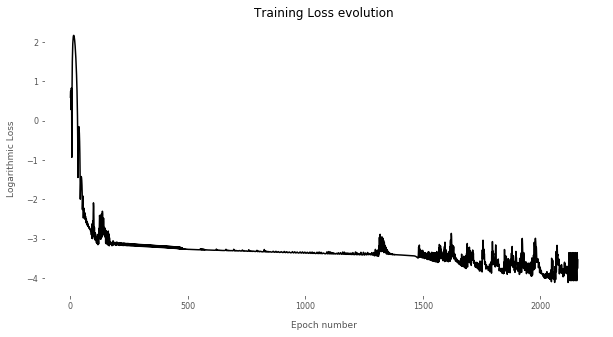

In [5]:
res = experiments.trainNeuralNetworkImpliedVolatility(dataSet, 
                                                      hyperparameters, 
                                                      scaler, 
                                                      False)
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): -4.12
Best Penalization :  [0.016319046, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[0.0, 0.0]]
Refined Grid evaluation :
Number of arbitrage violation :  1842
Dataset Grid evaluation :
Number of arbitrage violation :  14
Number of static arbitrage violations :  14
Arbitrable total variance :  Strike  Maturity
1550.0  0.093       0.038785
3145.0  0.074       0.002278
3150.0  0.063       0.002360
        0.074       0.002353
3160.0  0.093       0.002472
3170.0  0.093       0.002623
3175.0  0.112       0.002671
3225.0  0.151       0.003369
3250.0  0.151       0.003840
        0.170     

/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


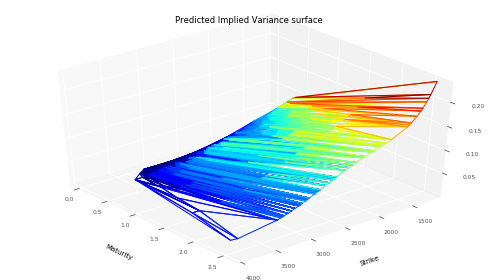

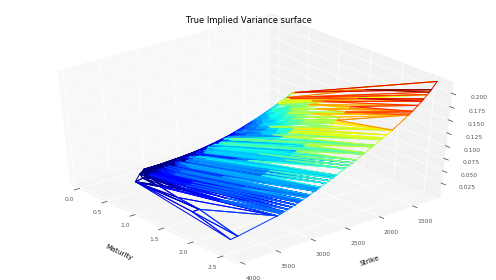

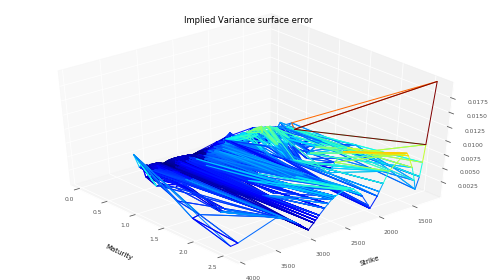

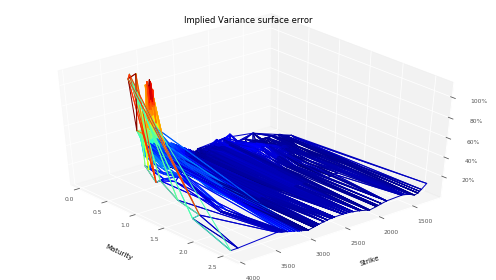

RMSE :  0.0014953803863470183
RMSE Relative:  0.20760825851953102


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


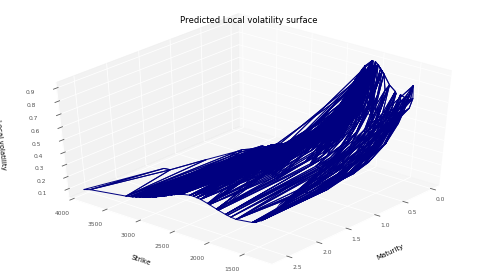

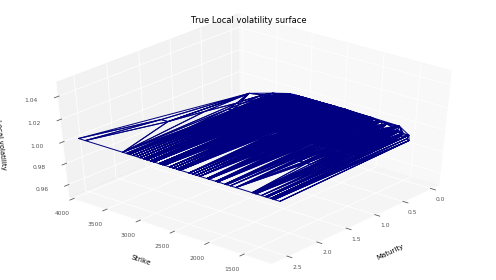

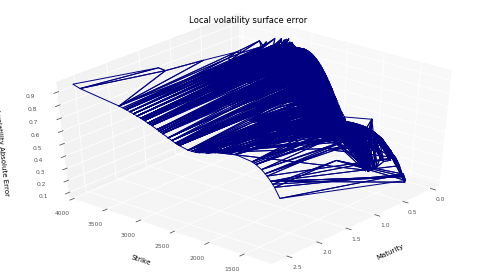

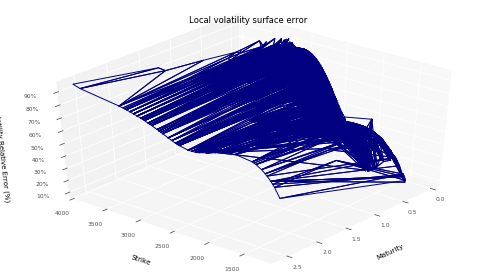

RMSE :  0.7392804766904887
RMSE Relative:  0.7392804766904887


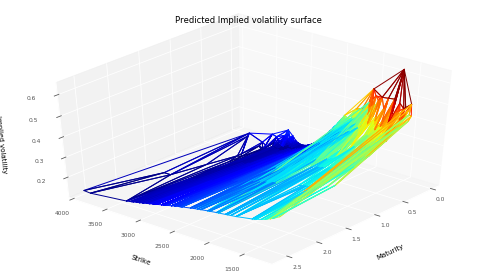

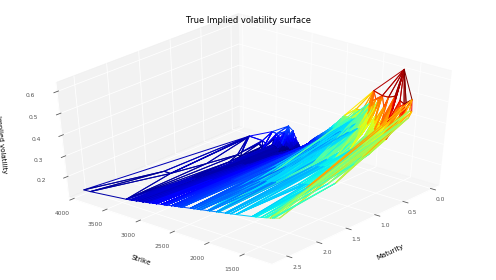

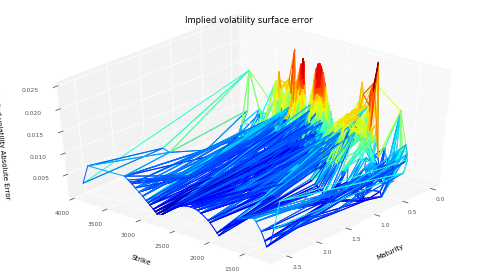

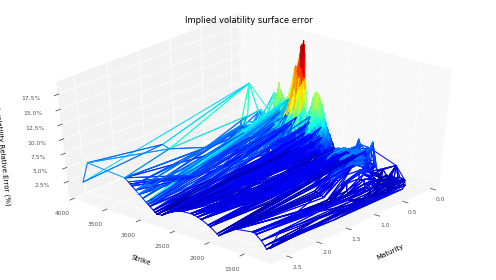

RMSE :  0.009180037545263938
RMSE Relative:  0.054561048499973445


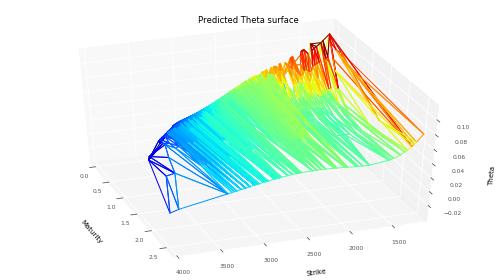

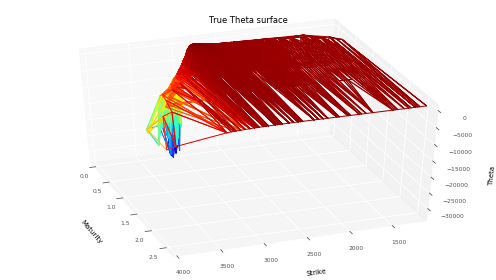

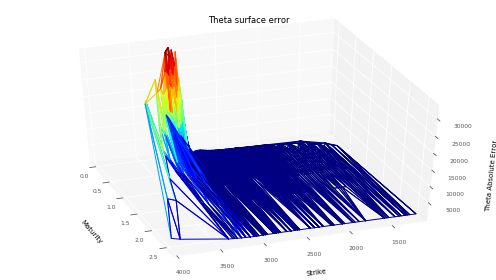

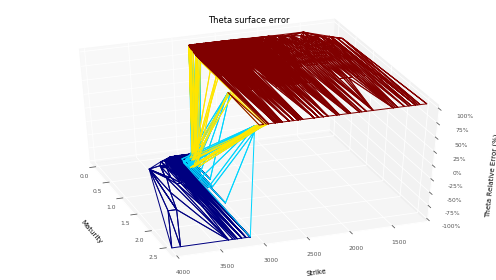

RMSE :  5822.438895946285
RMSE Relative:  0.9993108993737911


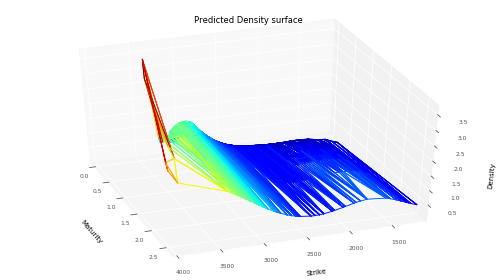

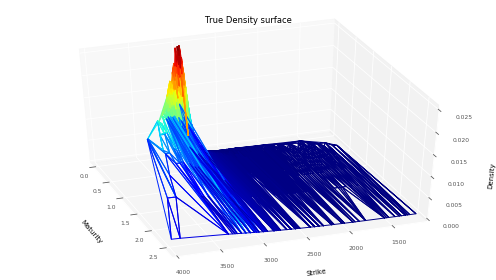

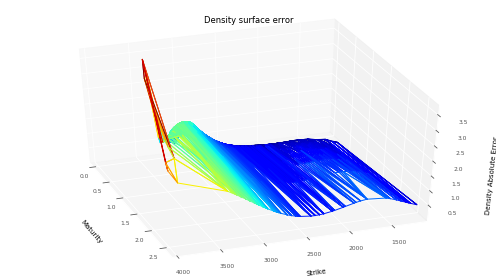

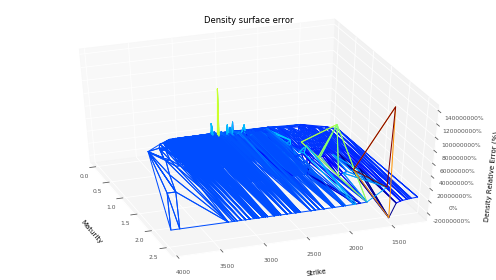

RMSE :  0.7975331759123613
RMSE Relative:  48251.61069205206


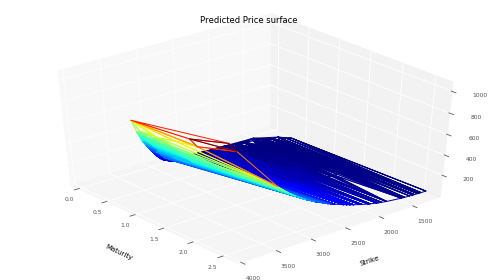

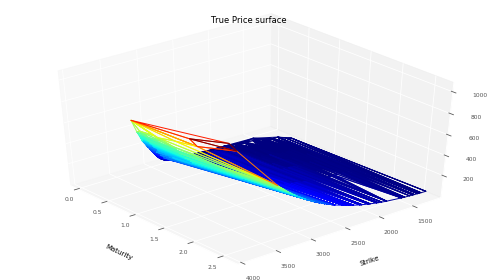

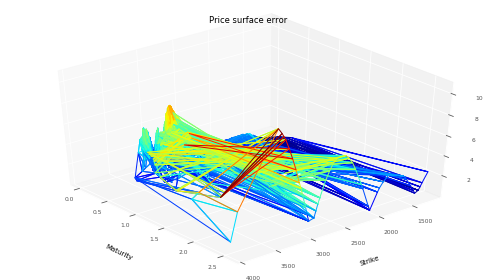

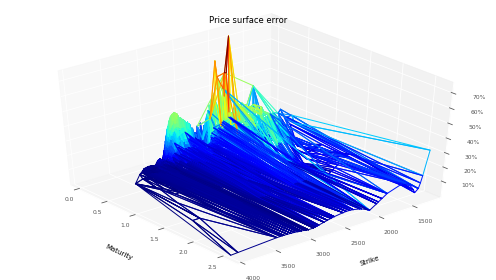

RMSE :  2.3849517881320144
RMSE Relative:  0.1373501197260295
ATM Local Volatility : 
Strike  Maturity
2860.0  0.055       0.125509
        0.074       0.129753
        0.082       0.131051
        0.093       0.132924
        0.370       0.146290
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  14
Arbitrable total variance :  Strike  Maturity
1550.0  0.093       0.038785
3145.0  0.074       0.002278
3150.0  0.063       0.002360
        0.074       0.002353
3160.0  0.093       0.002472
3170.0  0.093       0.002623
3175.0  0.112       0.002671
3225.0  0.151       0.003369
3250.0  0.151       0.003840
        0.170       0.003741
3300.0  0.170       0.004922
3350.0  0.285       0.005404
3500.0  0.342       0.010653
        0.370       0.009975
Name: Price, dtype: float32


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


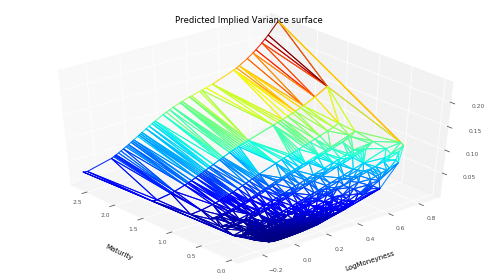

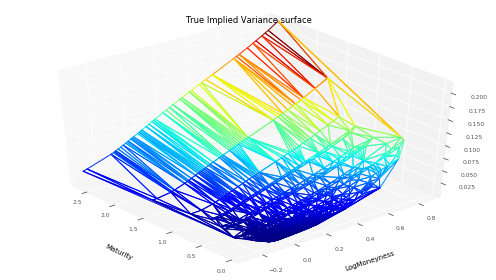

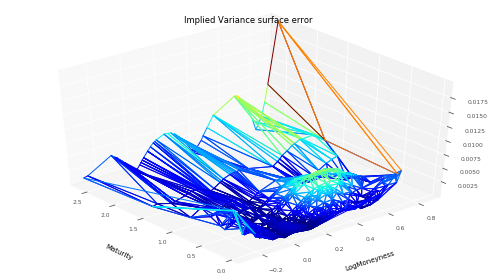

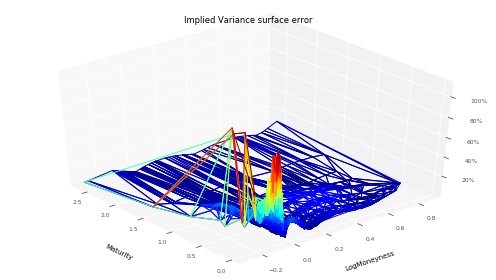

RMSE :  0.0014953803863470183
RMSE Relative:  0.20760825851953102


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


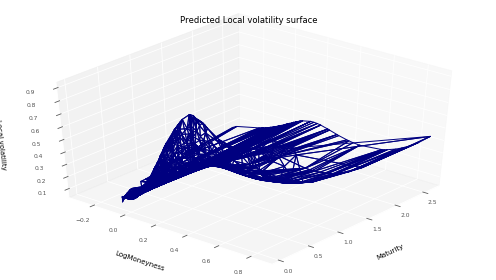

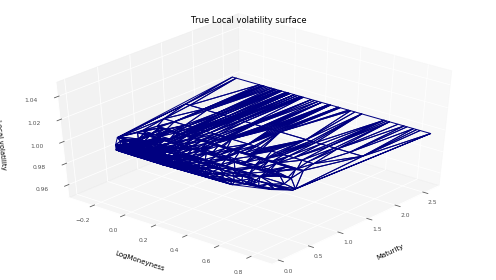

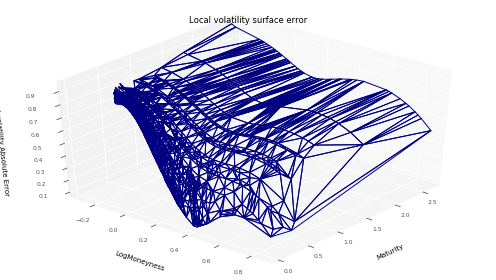

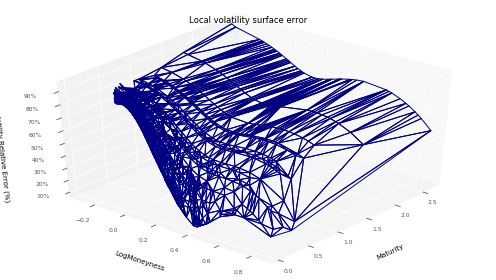

RMSE :  0.7392804766904887
RMSE Relative:  0.7392804766904887


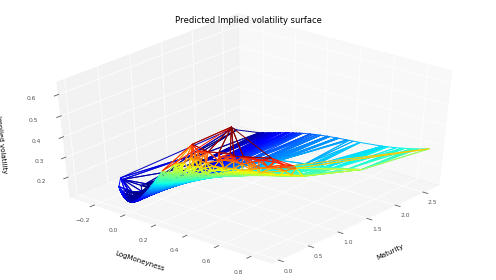

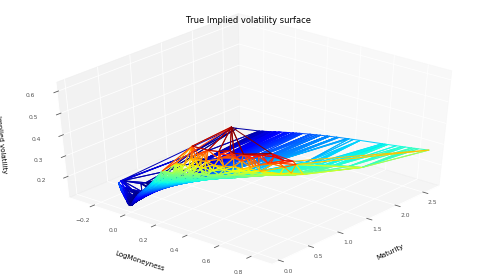

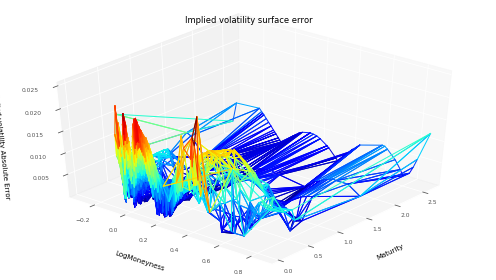

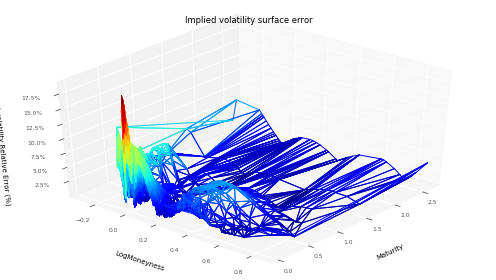

RMSE :  0.009180037545263938
RMSE Relative:  0.054561048499973445


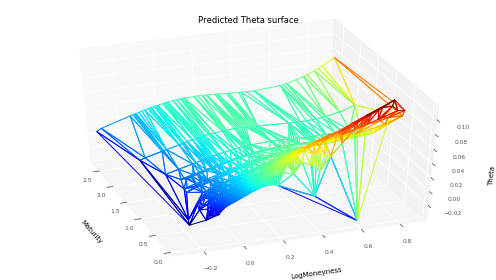

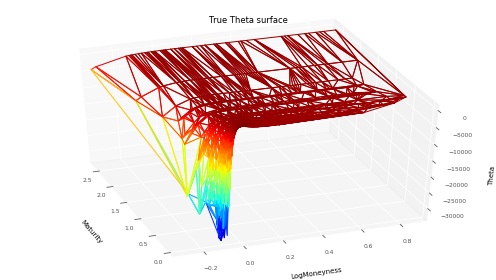

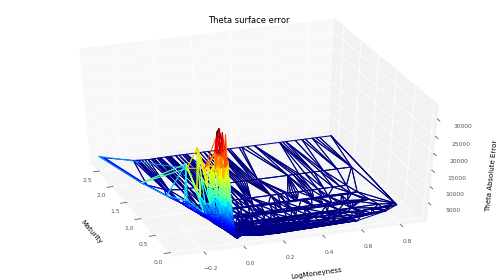

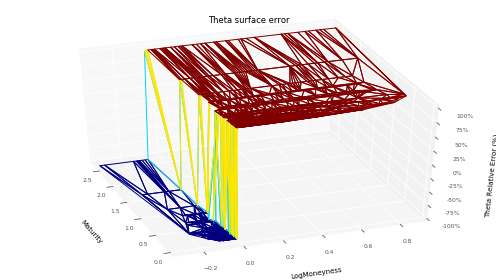

RMSE :  5822.438895946285
RMSE Relative:  0.9993108993737911


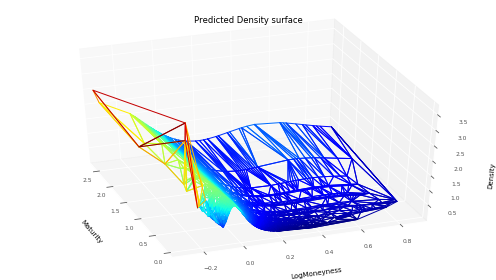

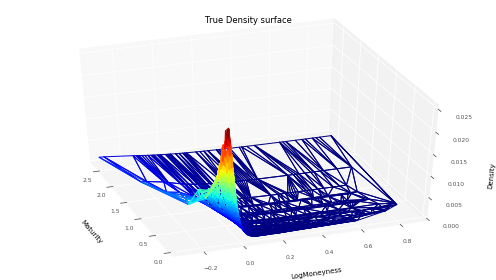

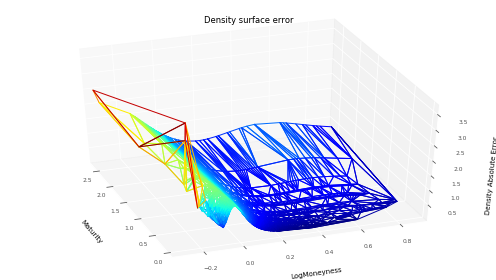

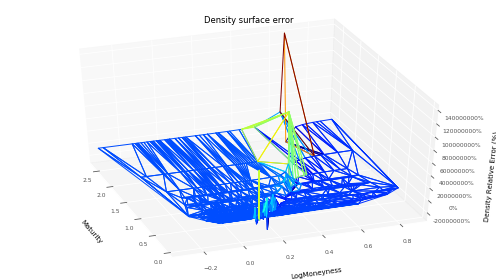

RMSE :  0.7975331759123613
RMSE Relative:  48251.61069205206


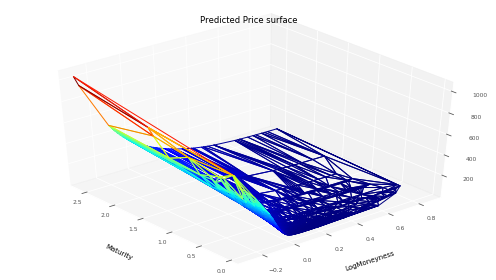

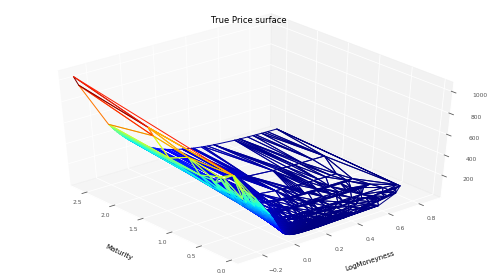

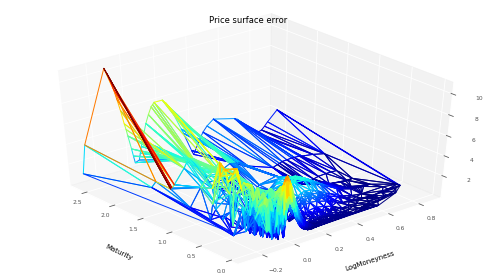

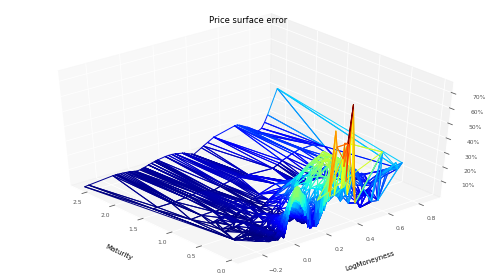

RMSE :  2.3849517881320144
RMSE Relative:  0.1373501197260295
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): -4.11
Best Penalization :  [0.016387088, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[0.0, 0.0]]
Refined Grid evaluation :
Number of arbitrage violation :  1842
Dataset Grid evaluation :
Number of arbitrage violation :  18
Number of static arbitrage violations :  18
Arbitrable total variance :  Strike  Maturity
1575.0  0.093       0.037477
1600.0  0.074       0.037767
1650.0  0.074       0.034826
1675.0  0.093       0.032406
3155.0  0.074       0.002433
3190.0  0.093       0.002978
3210.0  0.093       0.003416
3225.0  0.131  

/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


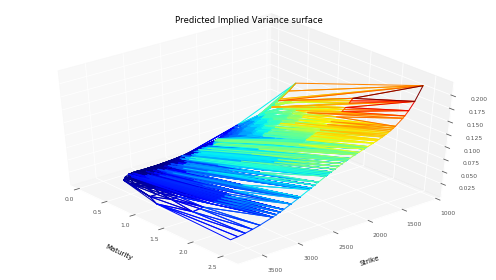

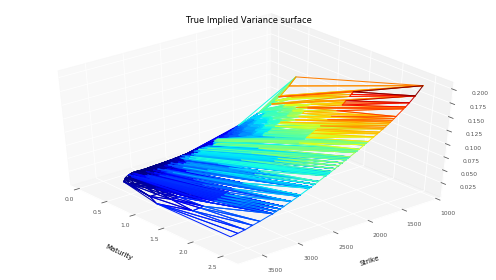

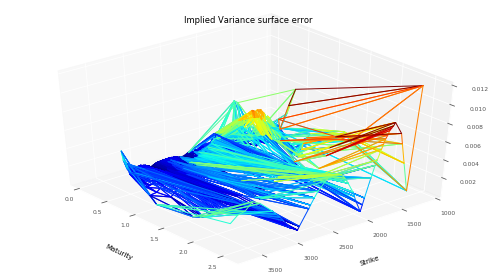

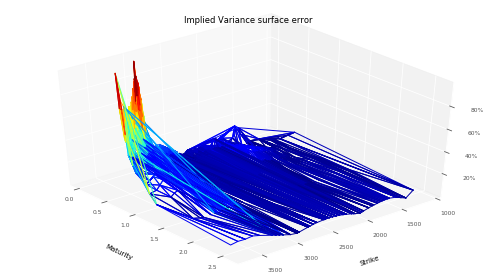

RMSE :  0.0015404602544538905
RMSE Relative:  0.19764266483539877


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


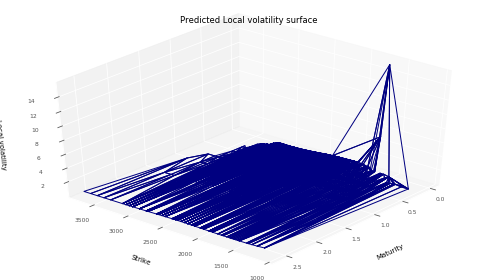

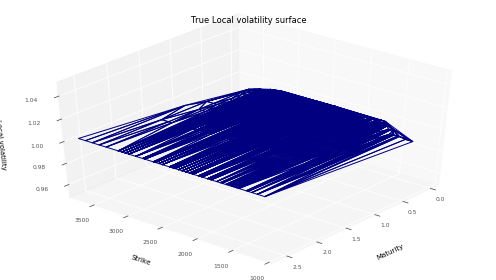

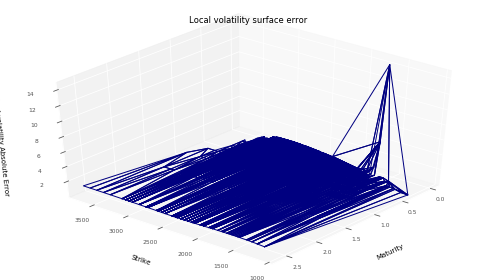

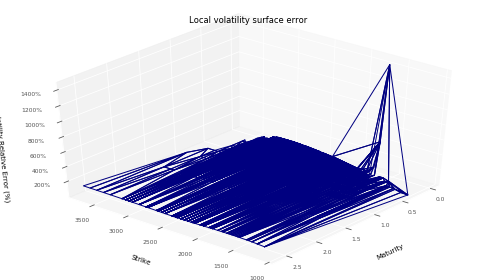

RMSE :  0.8242225010087717
RMSE Relative:  0.8242225010087717


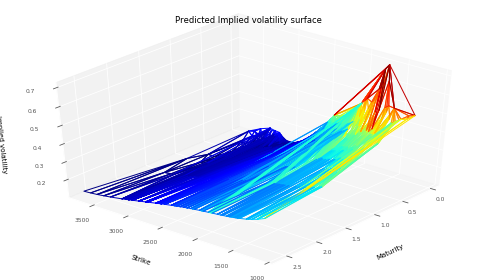

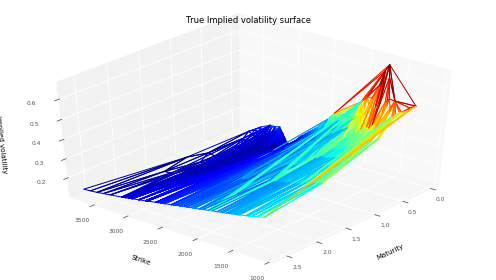

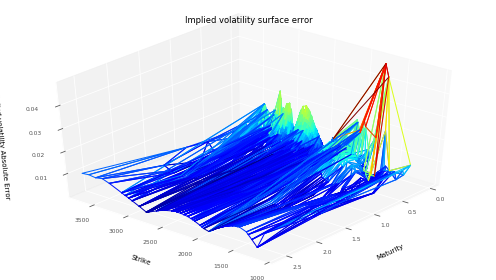

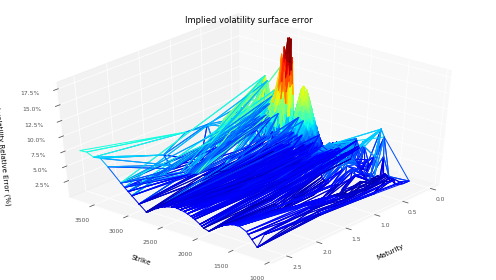

RMSE :  0.009249294558392254
RMSE Relative:  0.053726414356363904


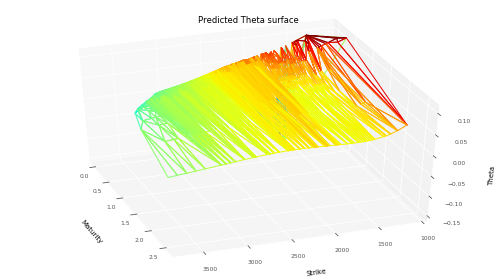

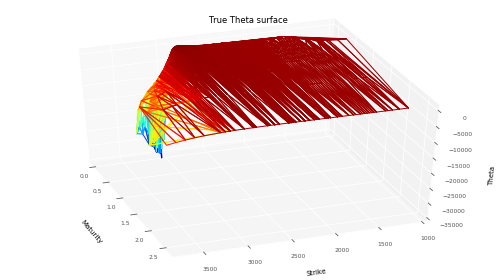

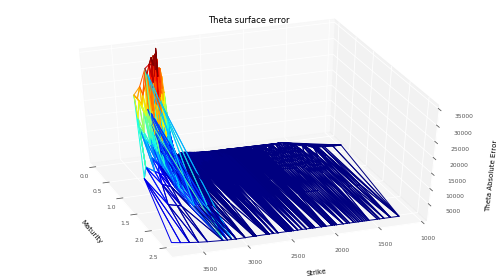

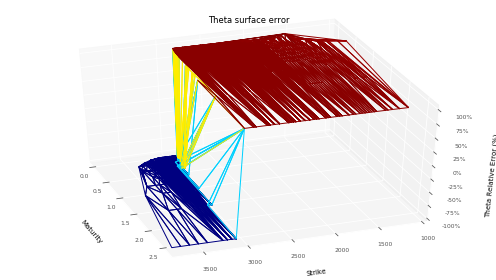

RMSE :  5770.469243775146
RMSE Relative:  0.9993398906789163


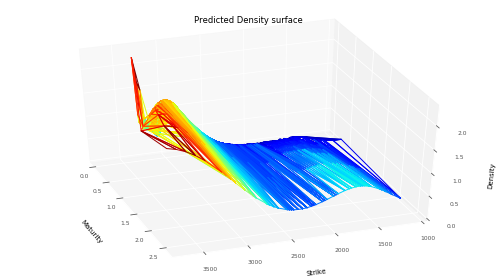

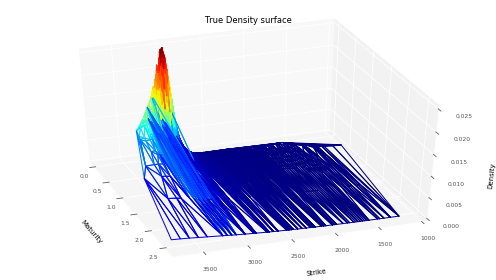

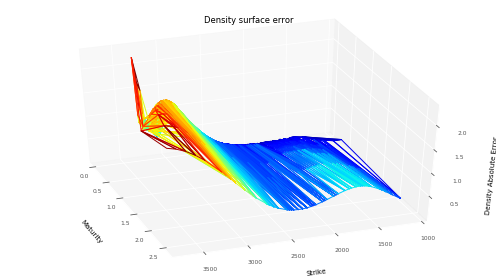

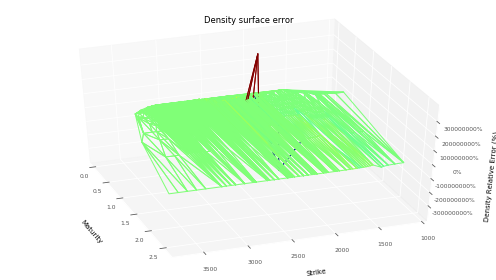

RMSE :  0.8031373165354992
RMSE Relative:  142209.70861049573


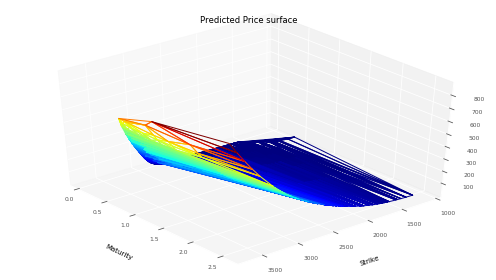

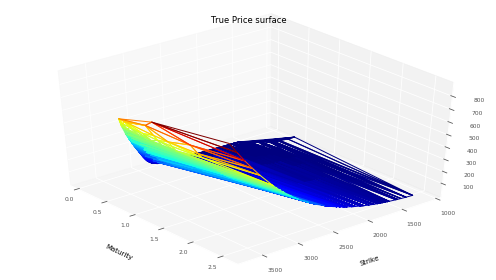

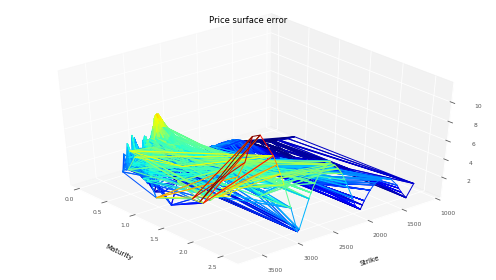

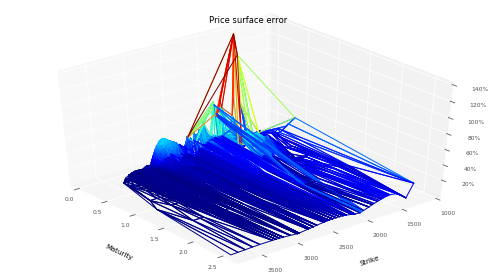

RMSE :  2.4215268848605485
RMSE Relative:  0.1448704792335927
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  18
Arbitrable total variance :  Strike  Maturity
1575.0  0.093       0.037477
1600.0  0.074       0.037767
1650.0  0.074       0.034826
1675.0  0.093       0.032406
3155.0  0.074       0.002433
3190.0  0.093       0.002978
3210.0  0.093       0.003416
3225.0  0.131       0.003449
3275.0  0.170       0.004256
3300.0  0.151       0.005235
        0.189       0.004698
        0.203       0.004597
        0.246       0.004513
3350.0  0.203       0.006086
        0.246       0.005627
3400.0  0.246       0.007455
        0.342       0.006401
        0.370       0.006327
Name: Price, dtype: float32


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


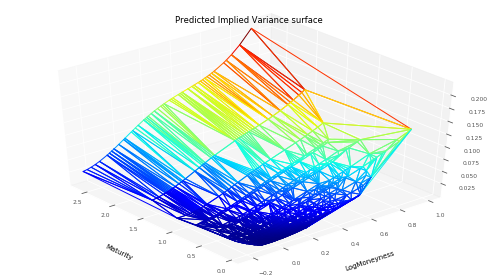

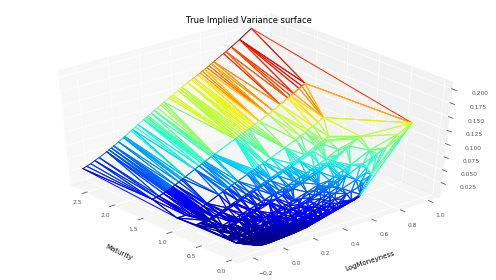

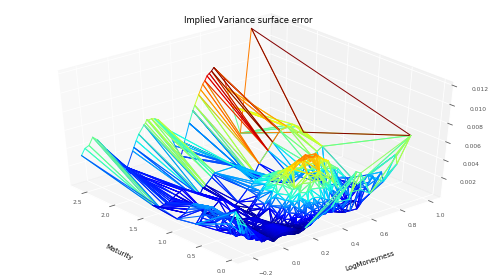

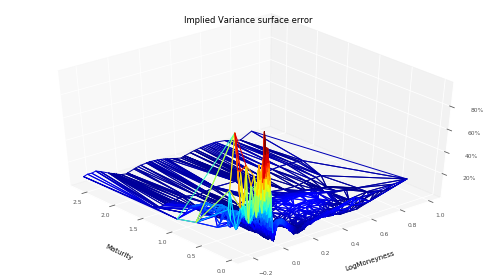

RMSE :  0.0015404602544538905
RMSE Relative:  0.19764266483539877


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


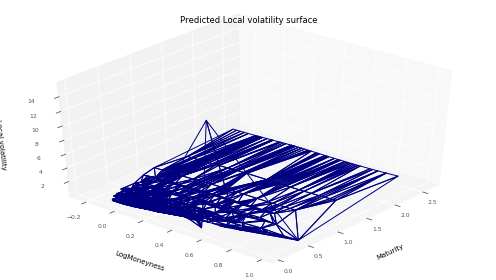

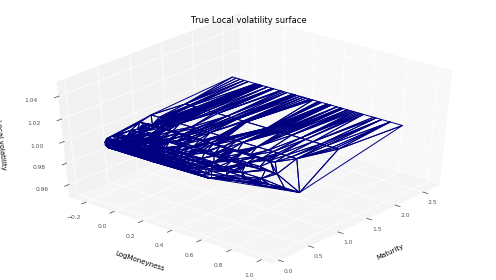

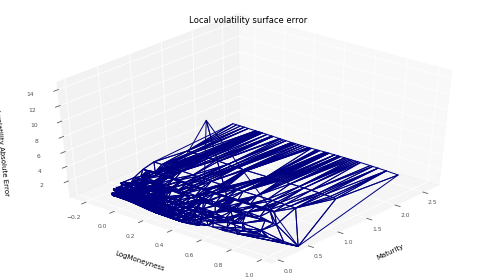

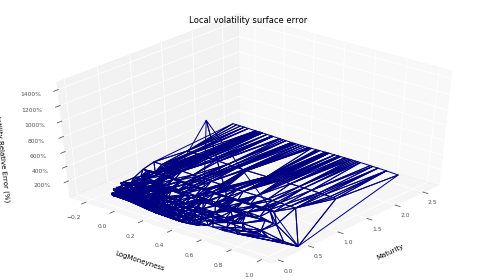

RMSE :  0.8242225010087717
RMSE Relative:  0.8242225010087717


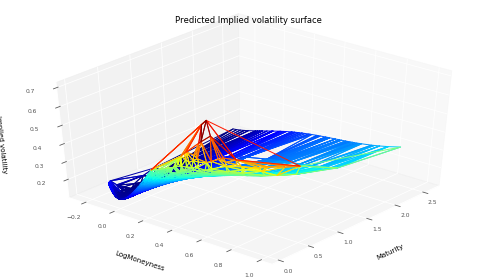

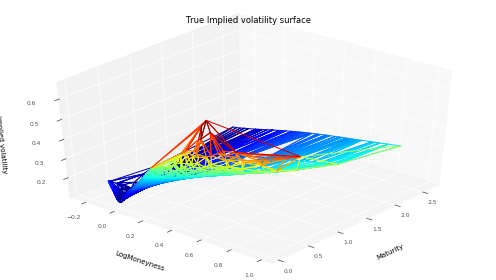

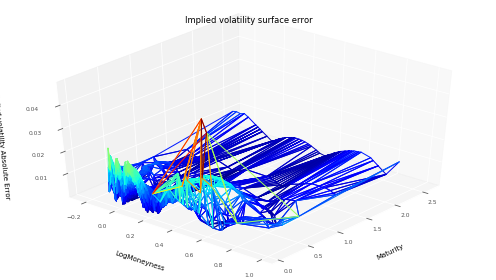

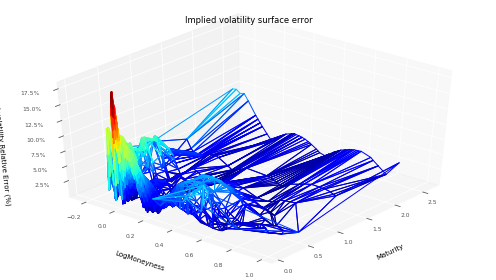

RMSE :  0.009249294558392254
RMSE Relative:  0.053726414356363904


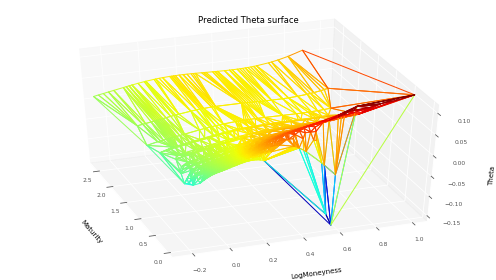

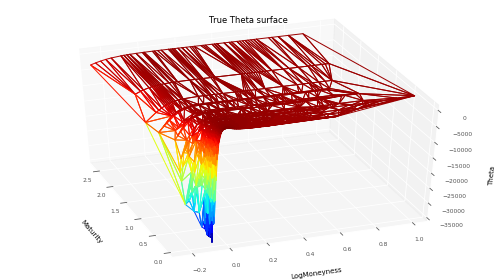

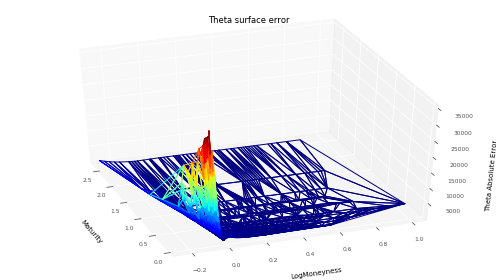

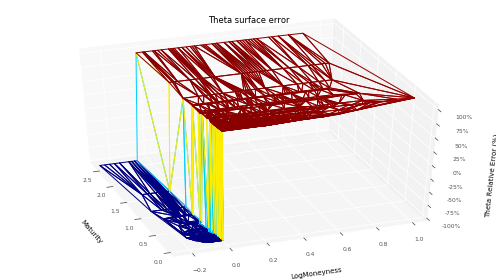

RMSE :  5770.469243775146
RMSE Relative:  0.9993398906789163


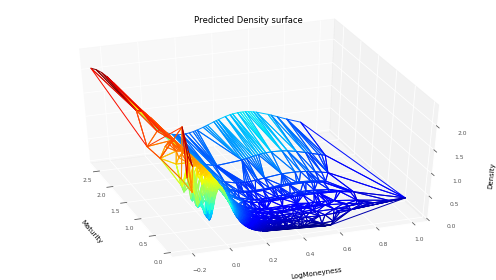

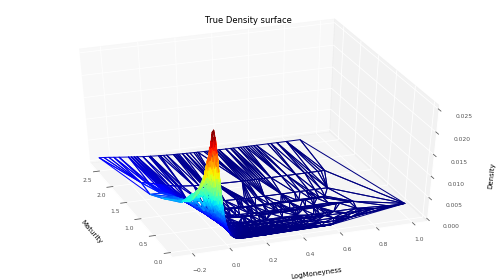

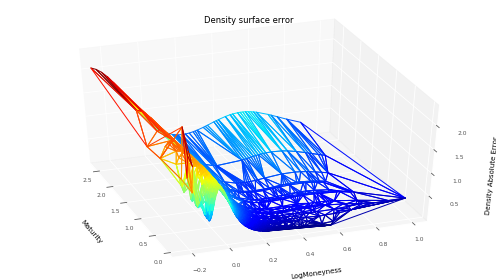

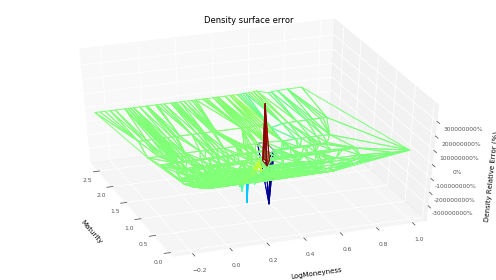

RMSE :  0.8031373165354992
RMSE Relative:  142209.70861049573


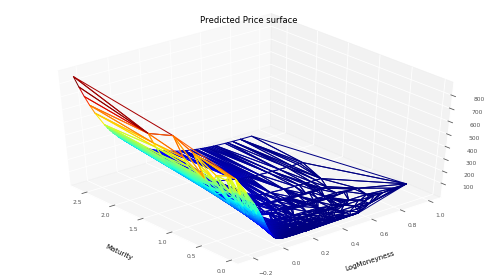

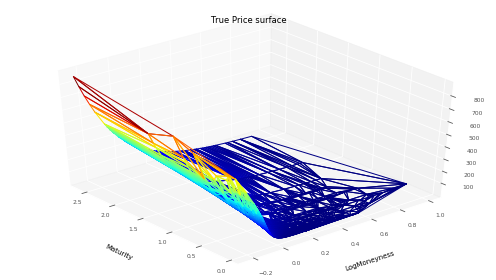

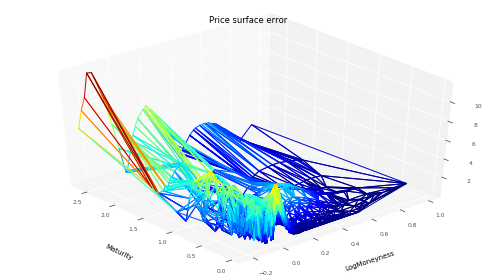

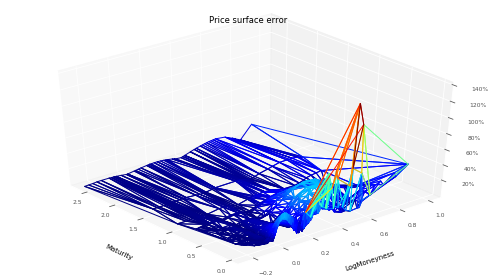

RMSE :  2.4215268848605485
RMSE Relative:  0.1448704792335927


In [6]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableImpliedVolatility(dataSet, 
                                                                                 dataSetTest,
                                                                                 hyperparameters,
                                                                                 scaler,
                                                                                 KMin,
                                                                                 KMax,
                                                                                 S0, midS0,
                                                                                 bootstrap)

#### With arbitrage constraint

In [7]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 1.0#0.1#0.0#0.1#0.11#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 100.0#0.0#100.0#1.0#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10000.0#0.0#10000.0#10.0#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.000001#0.01
hyperparameters["lowerBoundGamma"] = 0.0#0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 1.00

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 200
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = True
hyperparameters["nbEpochFork"] = 0#10000
hyperparameters["lambdaFork"] = 0.0#1000.0
hyperparameters["HolderExponent"] =  2.0

/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Training w.r.t. implied vol RMSE and arbitrage constraints
Iteration :  3442 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 3443): -5.53
Best Penalization :  [0.003962373, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[3.5707836e-07, 0.0, 2.4188541e-06]]
Iteration :  3642 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 3643): -5.53
Best Penalization :  [0.003962373, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[3.5707836e-07, 0.0, 2.4188541e-06]]
Iteration :  3842 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 3843): -5.53
Best Penalization :  [0.003962373, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[3.5707836e-07, 0.0, 2.4188541e-06]]
Iteration :  4042 new learning rate :  1.0000000000000002e-06
Best loss (hidden nodes: 100, iterations: 4043): -5.53
Best Penalization :  [0.003962373, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[3.5707836e-07, 0.0, 2.4188541e-06]]

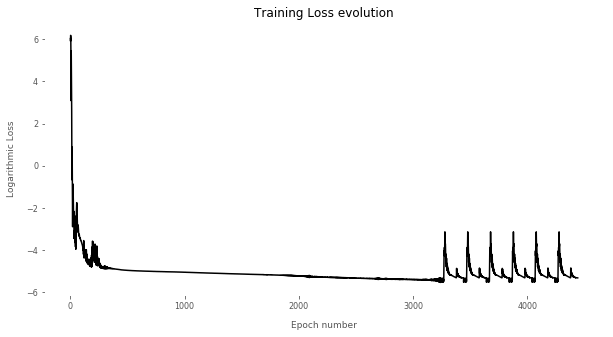

In [8]:
res = experiments.trainNeuralNetworkImpliedVolatility(dataSet, 
                                                      hyperparameters, 
                                                      scaler, 
                                                      True)
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): -5.53
Best Penalization :  [0.003962373, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid):  [[3.5707836e-07, 0.0, 2.4188541e-06]]
Refined Grid evaluation :
Number of arbitrage violation :  3
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


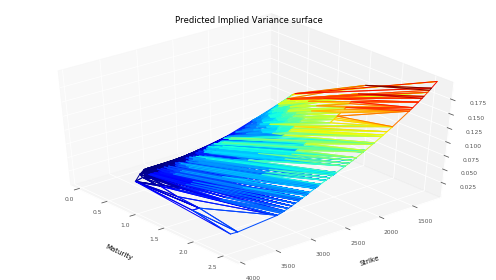

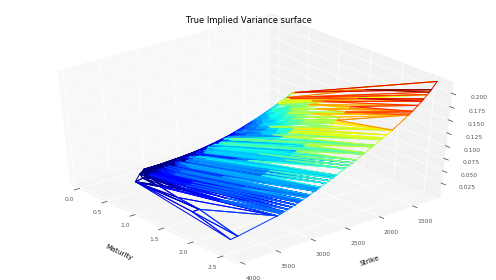

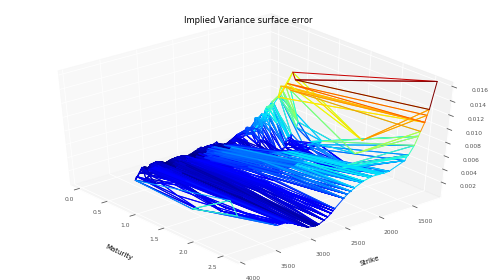

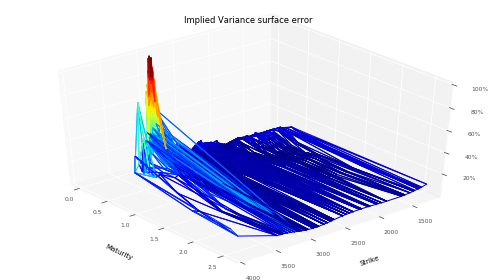

RMSE :  0.001482665195170363
RMSE Relative:  0.2279921050183424


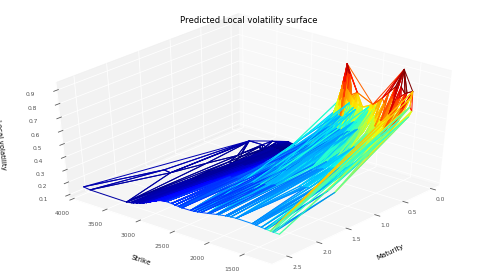

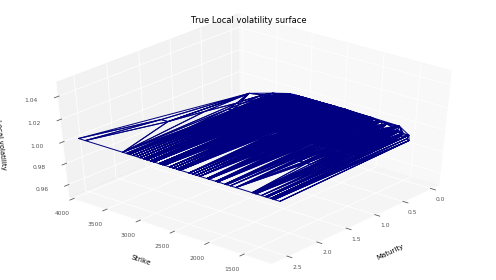

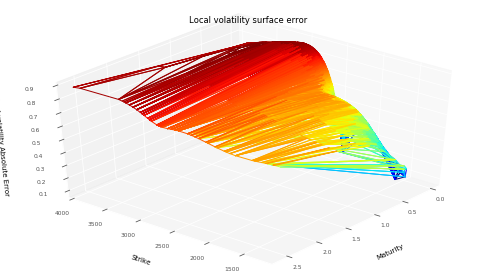

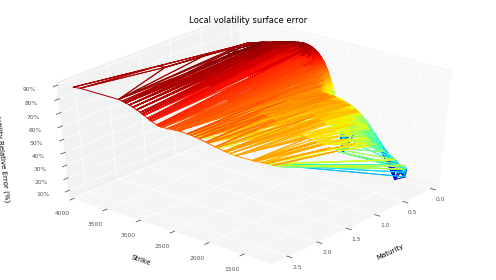

RMSE :  0.7428826261165821
RMSE Relative:  0.7428826261165821


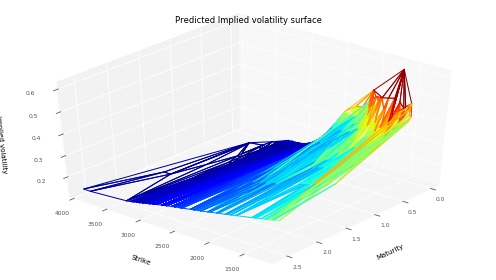

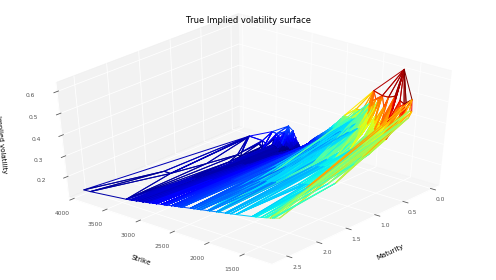

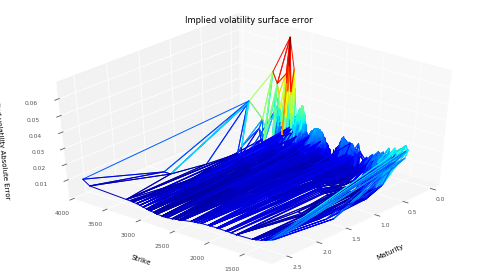

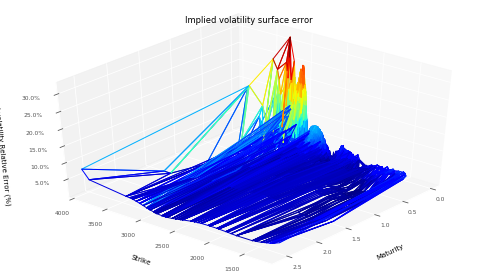

RMSE :  0.010764302095935629
RMSE Relative:  0.06903647940351894


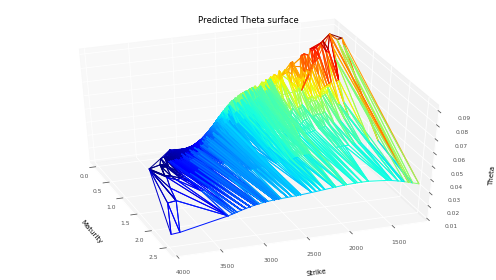

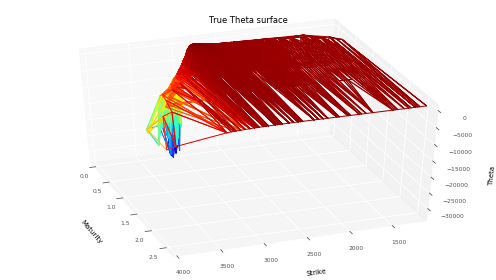

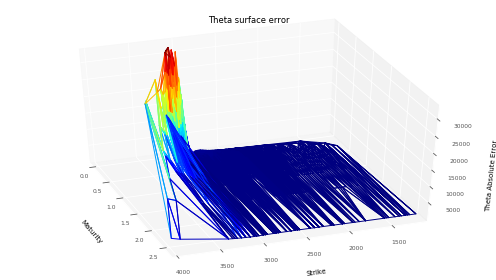

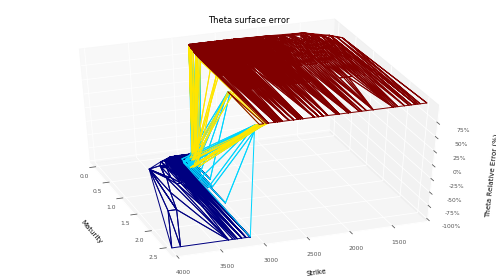

RMSE :  5822.44084109204
RMSE Relative:  0.9993391077363979


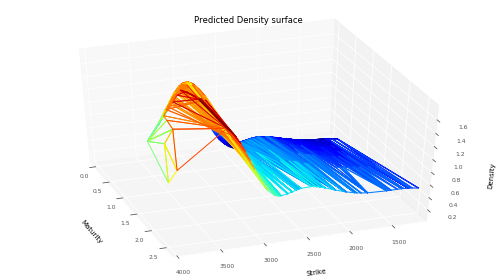

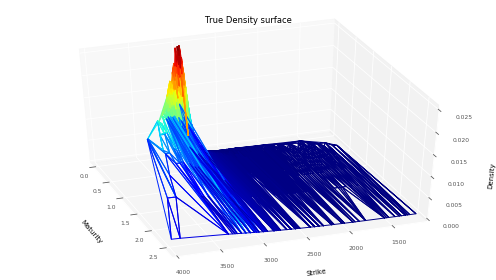

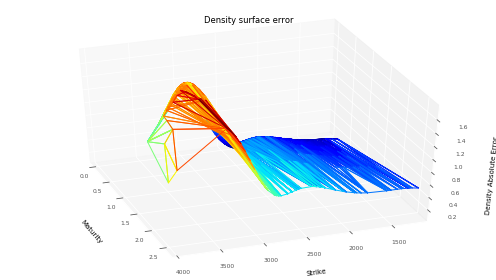

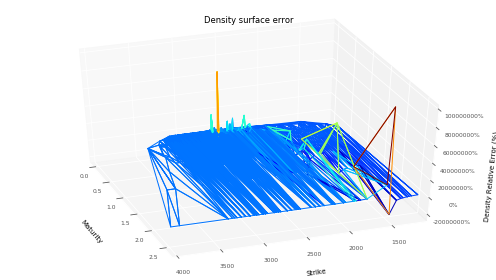

RMSE :  0.7798549007738508
RMSE Relative:  38217.62640999947


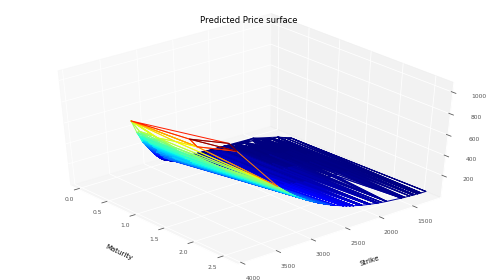

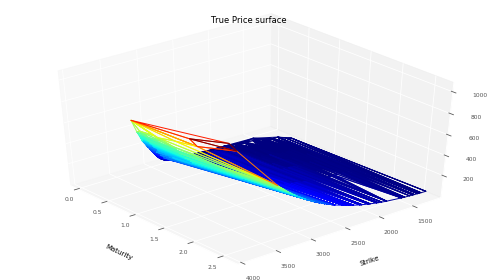

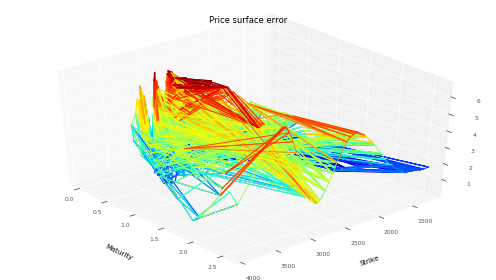

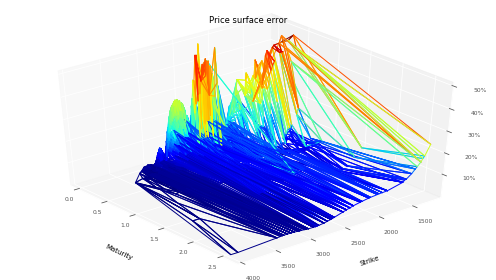

RMSE :  2.657678498543094
RMSE Relative:  0.12593435841115605
ATM Local Volatility : 
Strike  Maturity
2860.0  0.055       0.122731
        0.074       0.126934
        0.082       0.127823
        0.093       0.128902
        0.370       0.135438
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


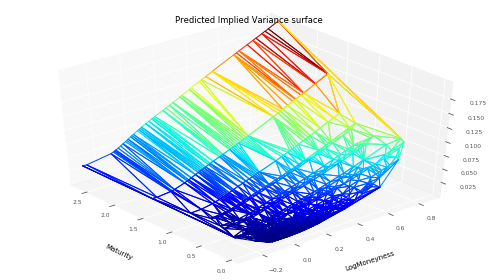

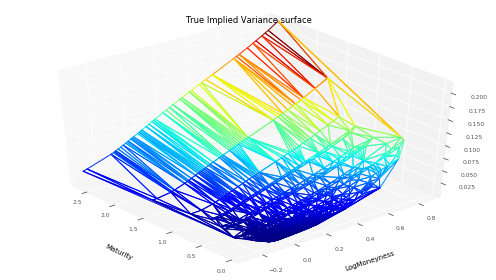

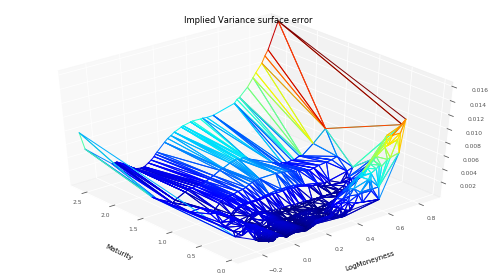

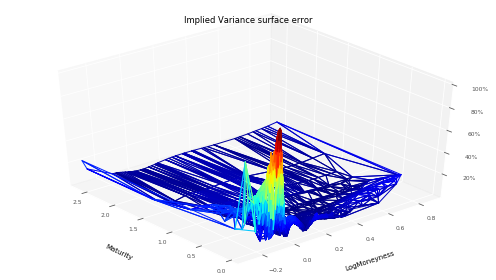

RMSE :  0.001482665195170363
RMSE Relative:  0.2279921050183424


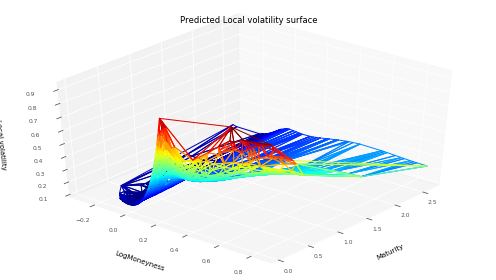

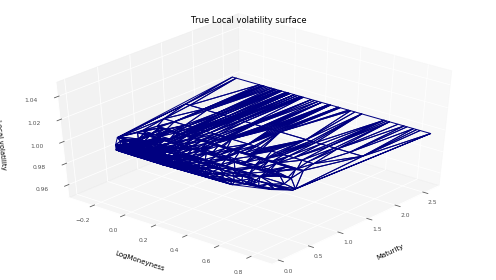

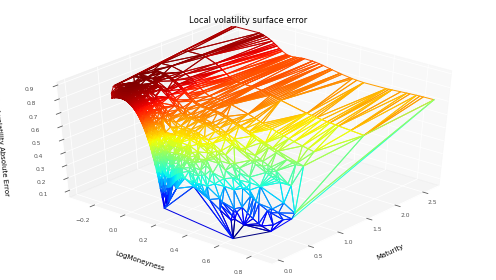

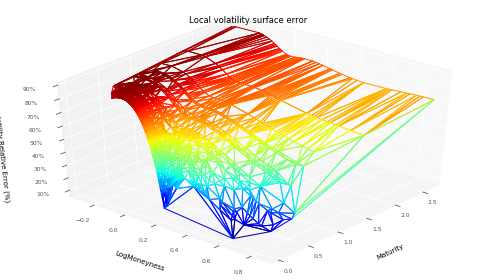

RMSE :  0.7428826261165821
RMSE Relative:  0.7428826261165821


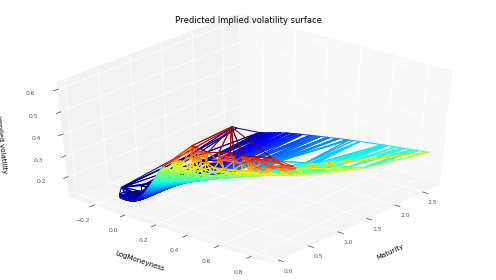

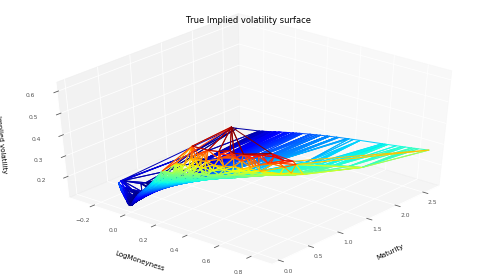

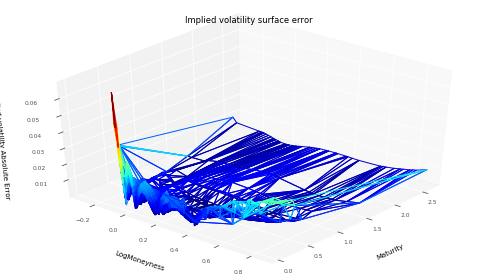

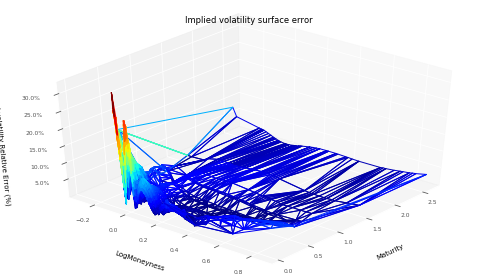

RMSE :  0.010764302095935629
RMSE Relative:  0.06903647940351894


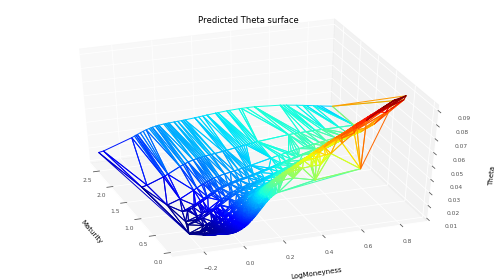

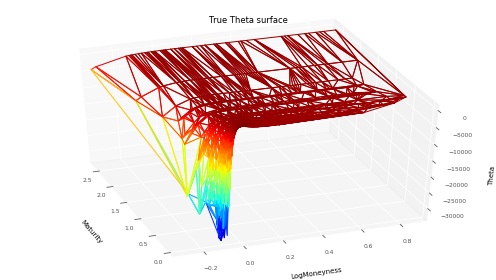

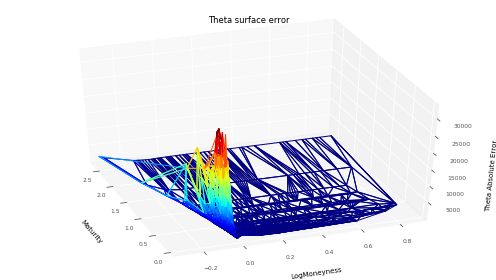

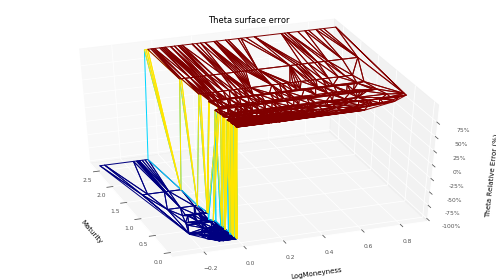

RMSE :  5822.44084109204
RMSE Relative:  0.9993391077363979


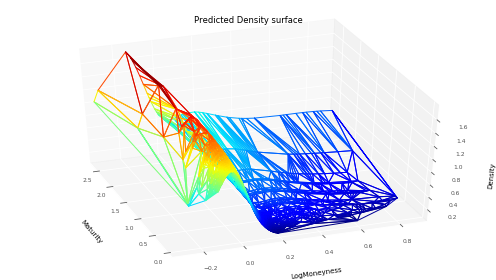

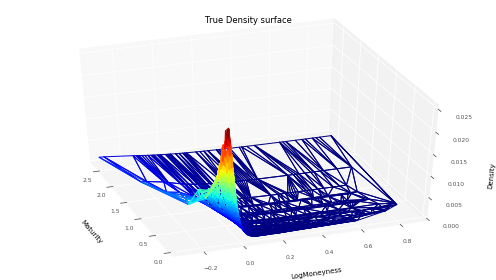

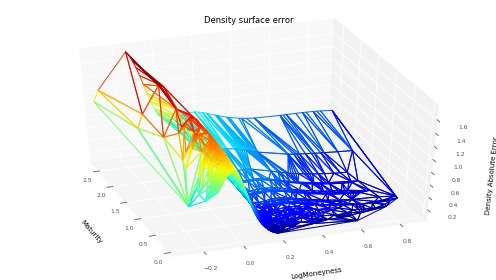

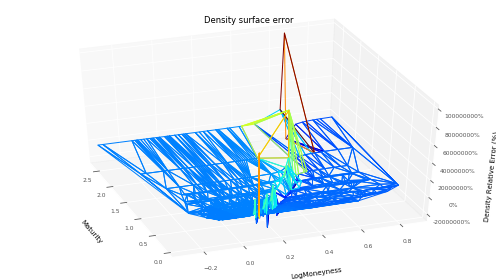

RMSE :  0.7798549007738508
RMSE Relative:  38217.62640999947


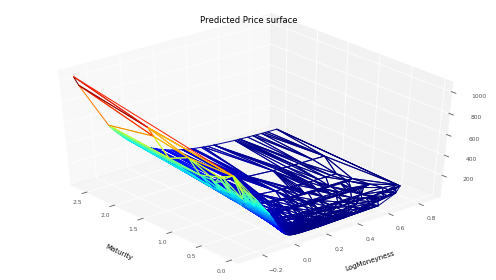

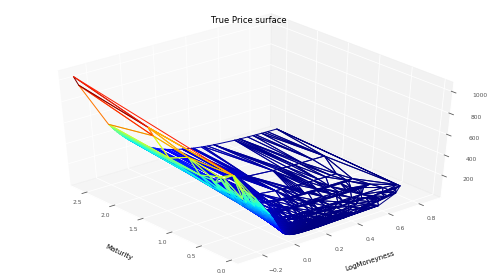

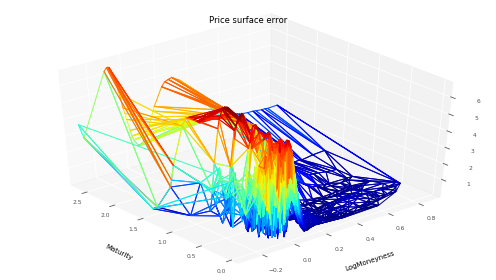

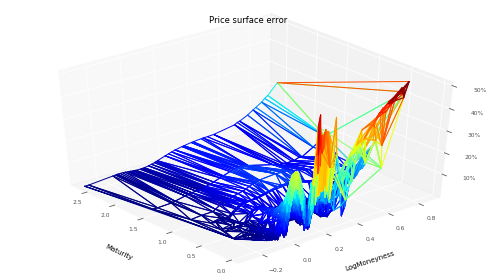

RMSE :  2.657678498543094
RMSE Relative:  0.12593435841115605
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): -5.48
Best Penalization :  [0.004181151, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid):  [[3.5229024e-07, 0.0, 2.3864193e-06]]
Refined Grid evaluation :
Number of arbitrage violation :  3
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


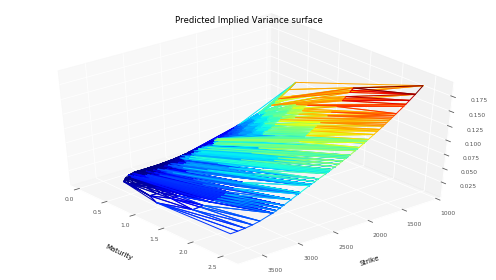

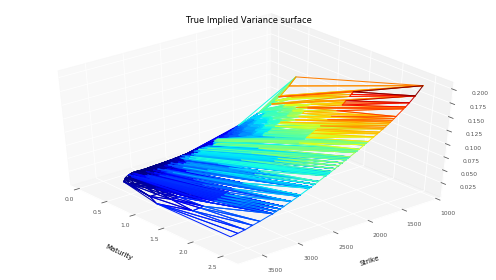

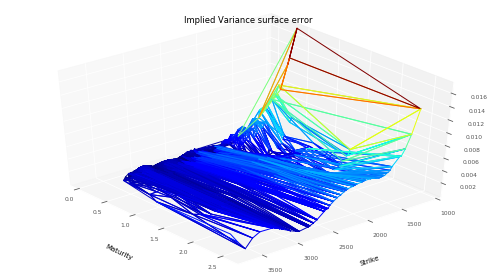

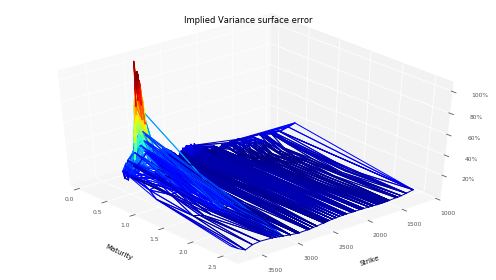

RMSE :  0.001451678566429619
RMSE Relative:  0.21175799301785347


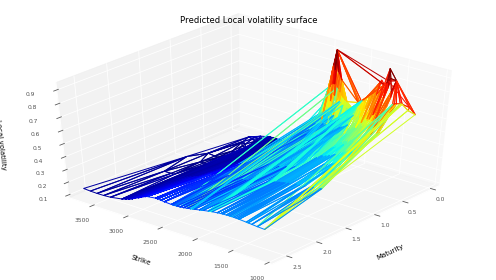

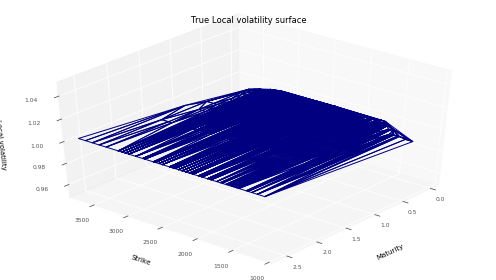

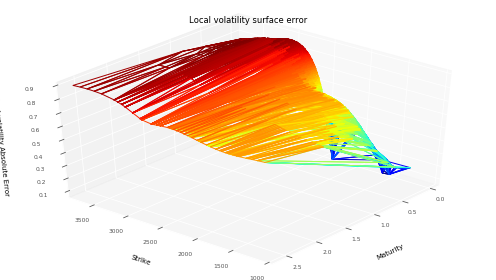

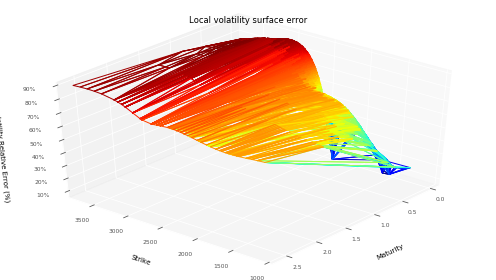

RMSE :  0.7394940764192789
RMSE Relative:  0.7394940764192789


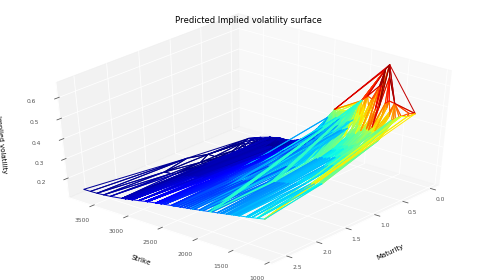

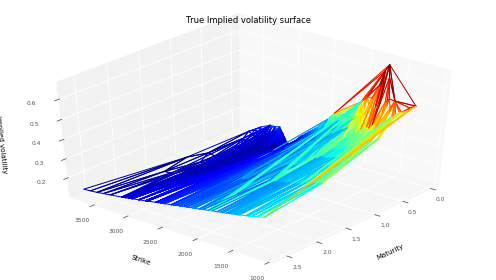

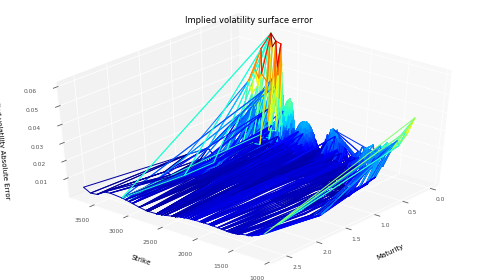

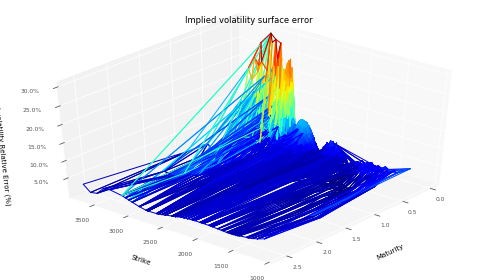

RMSE :  0.010988719871816077
RMSE Relative:  0.06906116443637458


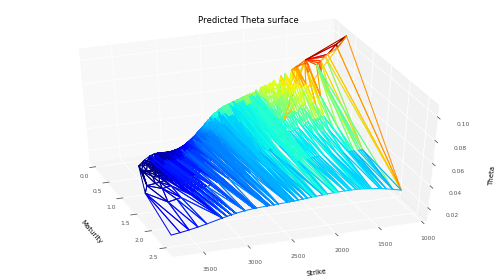

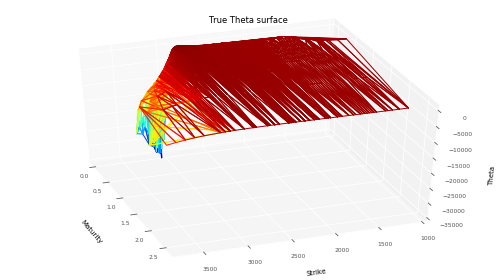

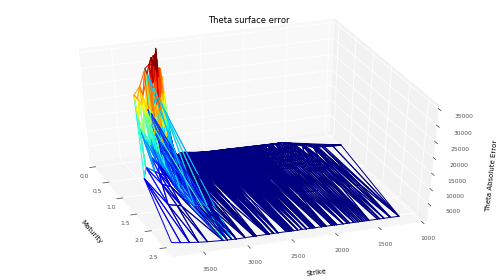

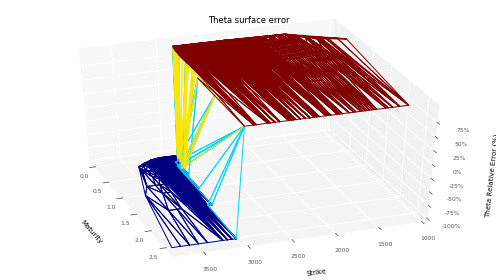

RMSE :  5770.471210697192
RMSE Relative:  0.9993029993011096


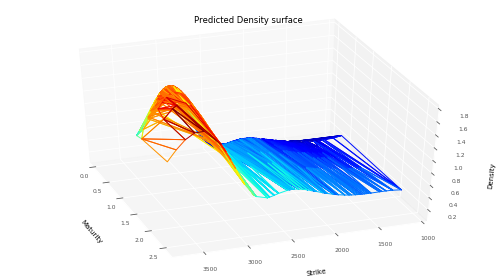

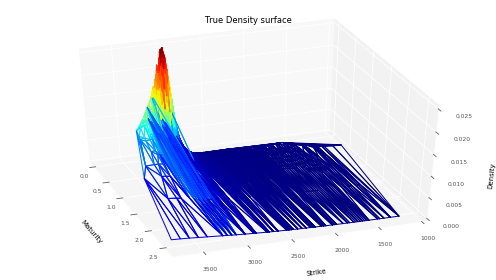

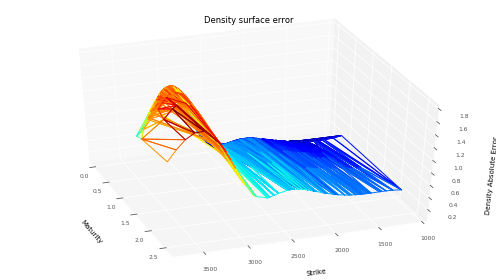

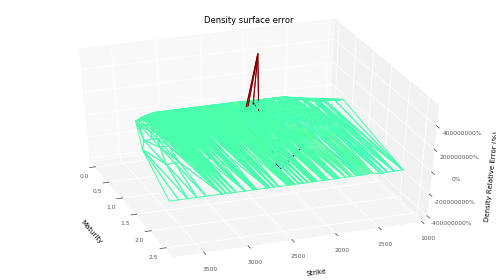

RMSE :  0.789674394090269
RMSE Relative:  172694.86356257202


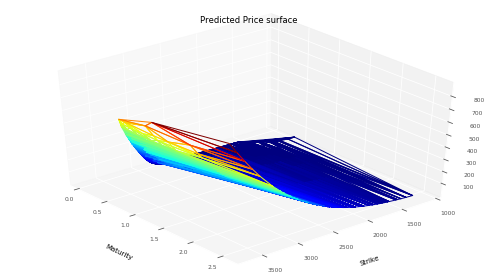

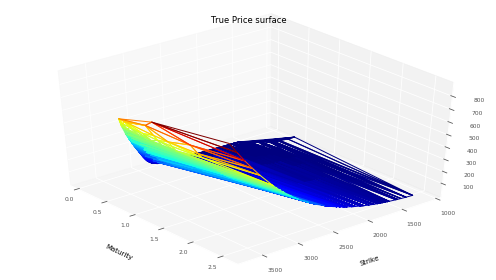

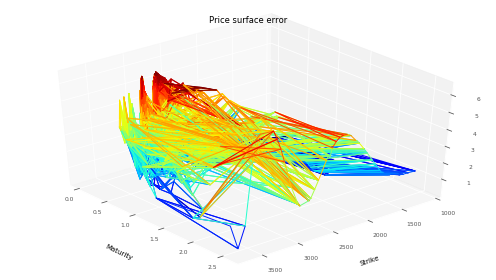

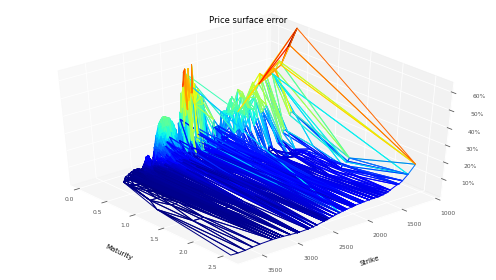

RMSE :  2.6604904114582326
RMSE Relative:  0.12925519922932935
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


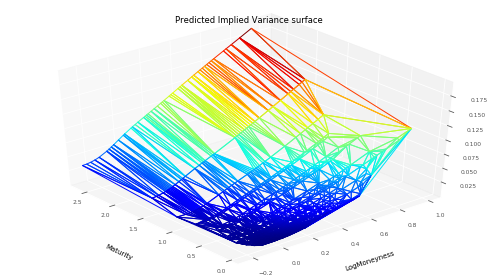

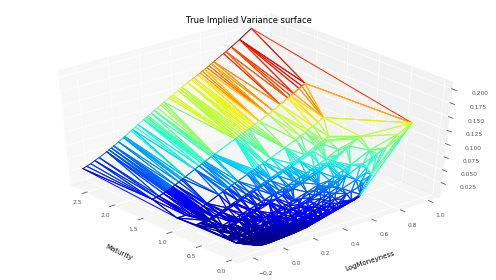

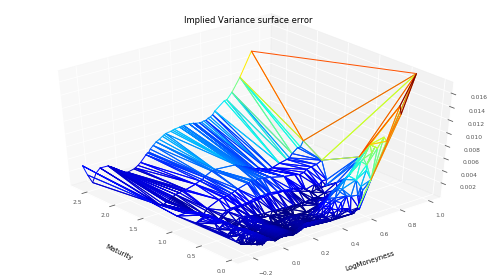

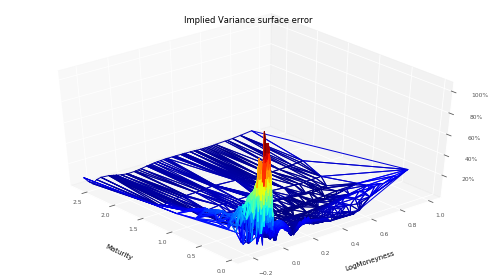

RMSE :  0.001451678566429619
RMSE Relative:  0.21175799301785347


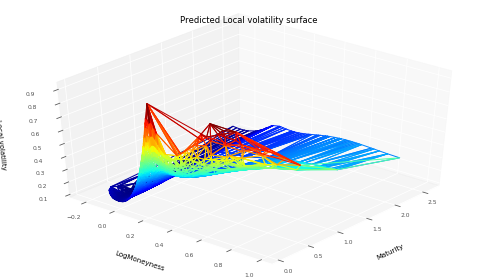

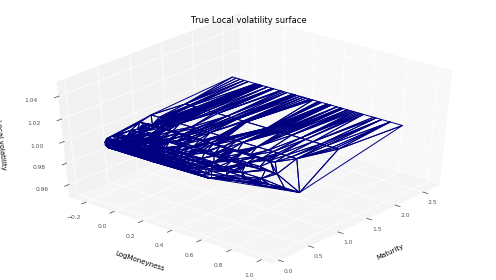

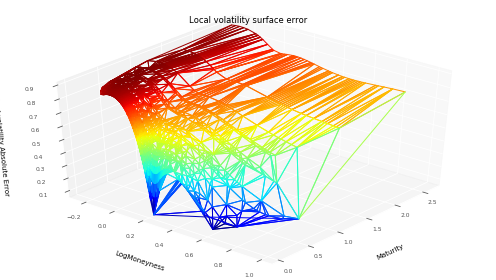

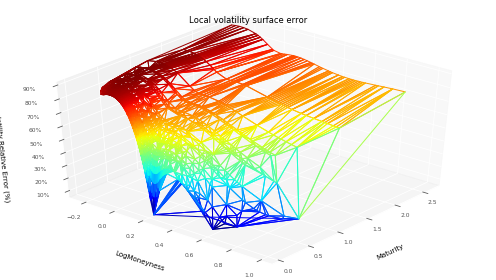

RMSE :  0.7394940764192789
RMSE Relative:  0.7394940764192789


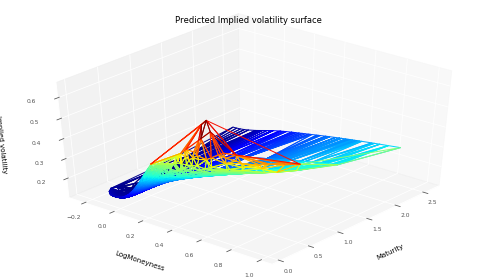

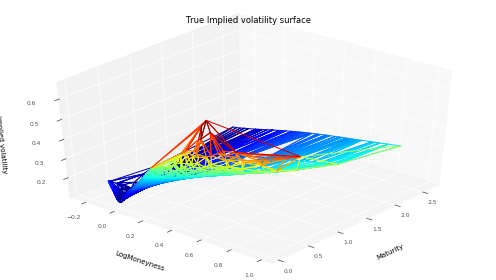

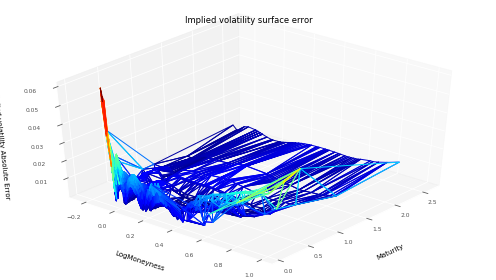

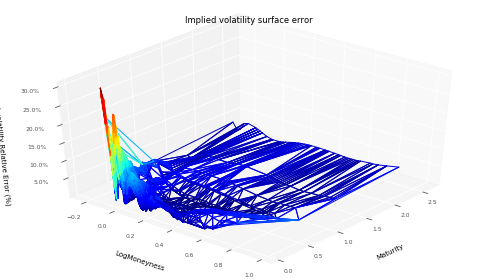

RMSE :  0.010988719871816077
RMSE Relative:  0.06906116443637458


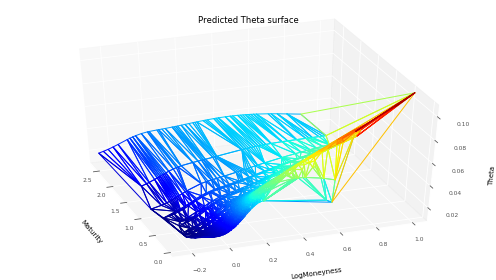

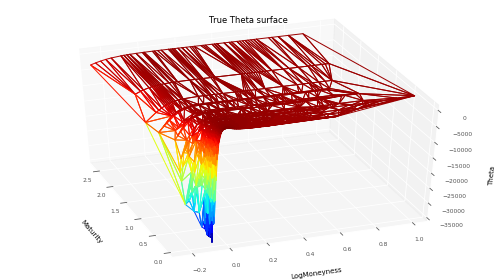

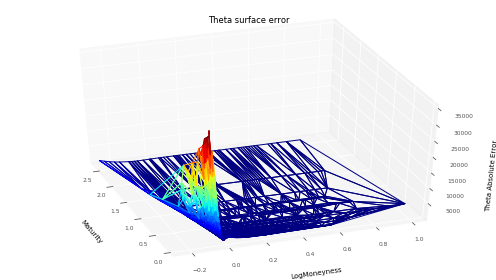

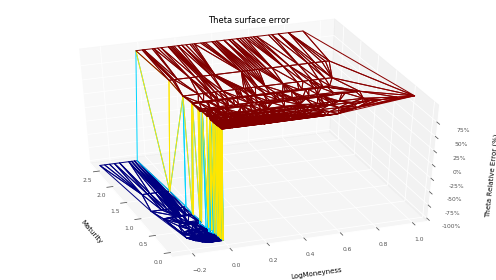

RMSE :  5770.471210697192
RMSE Relative:  0.9993029993011096


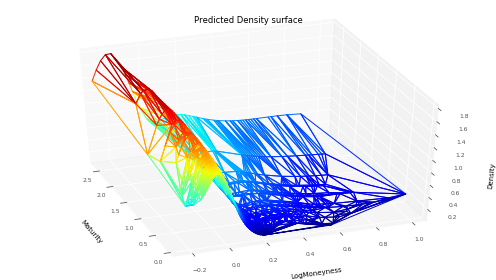

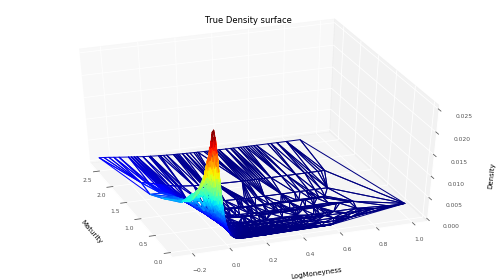

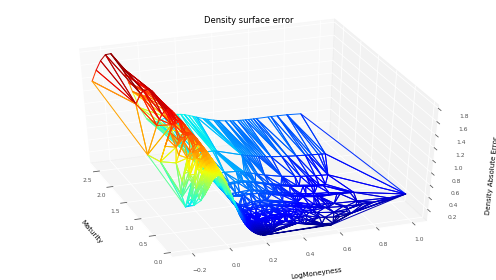

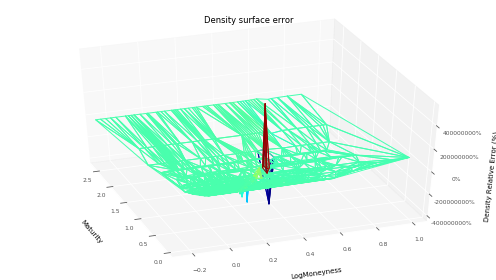

RMSE :  0.789674394090269
RMSE Relative:  172694.86356257202


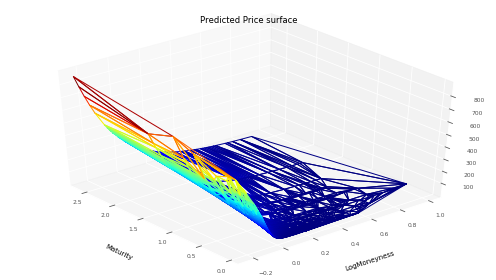

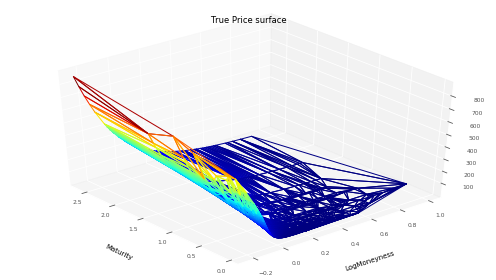

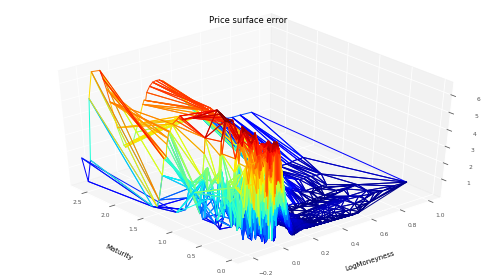

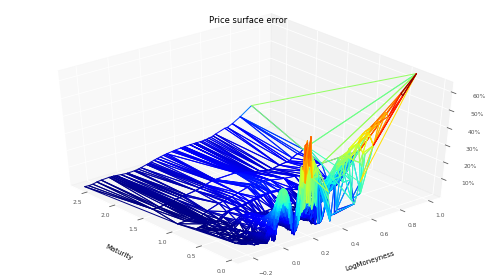

RMSE :  2.6604904114582326
RMSE Relative:  0.12925519922932935


In [9]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableFreeImpliedVolatility(dataSet, 
                                                                                     dataSetTest,
                                                                                     hyperparameters,
                                                                                     scaler,
                                                                                     KMin,
                                                                                     KMax,
                                                                                     S0, midS0,
                                                                                     bootstrap)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ d\log{S_t}  = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [10]:
# Function which evaluates neural local volatility when neural network is fitted on implied volatilities
def neuralVolLocaleGatheral(s,t):
    vLoc = neuralNetwork.evalVolLocaleGatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               s, t,
                                               dataSet,
                                               hyperparameters,
                                               scaler,
                                               bootstrap,
                                               S0,
                                               modelName = "convexSoftGatheralVolModel")
    return vLoc.dropna()

In [4]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


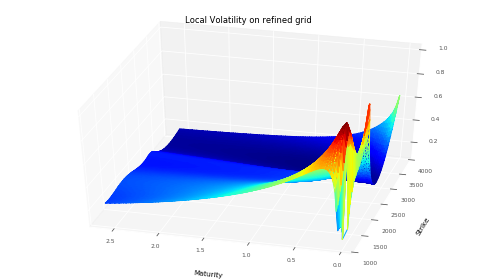

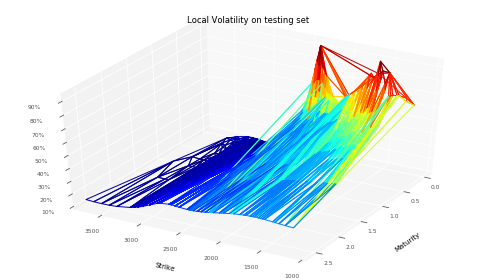

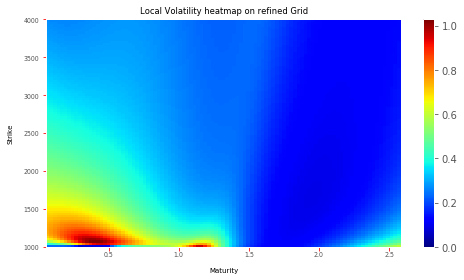

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


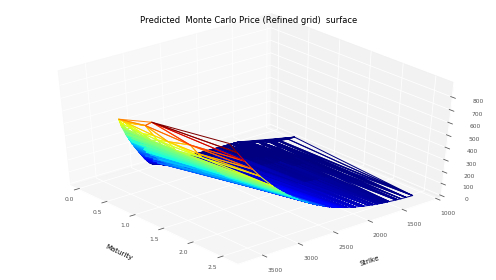

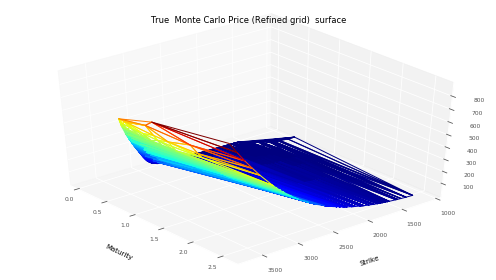

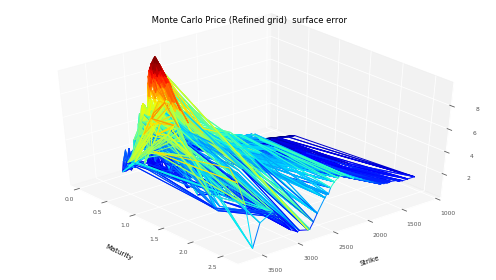

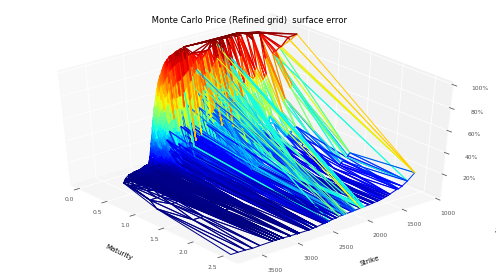

RMSE :  4.246436340924574
RMSE Relative:  0.41371014176702847


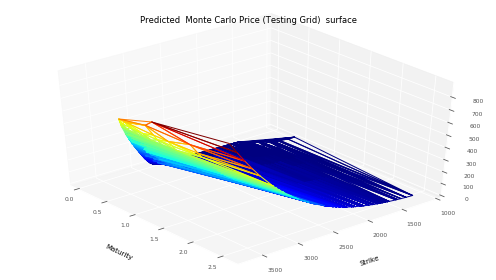

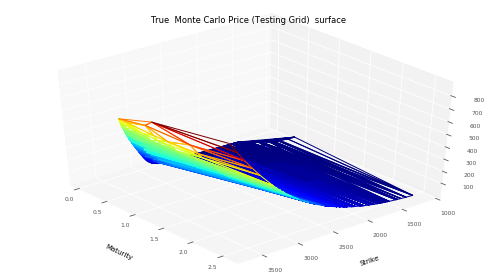

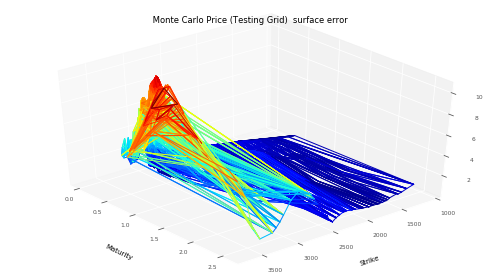

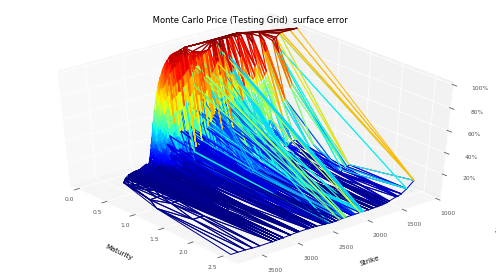

RMSE :  4.0498693763212135
RMSE Relative:  0.4033912087637376
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


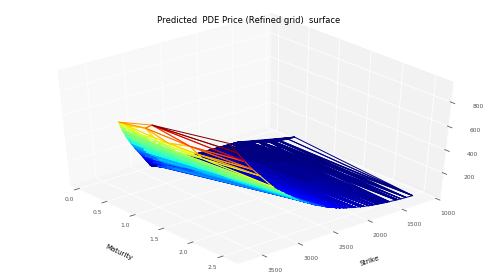

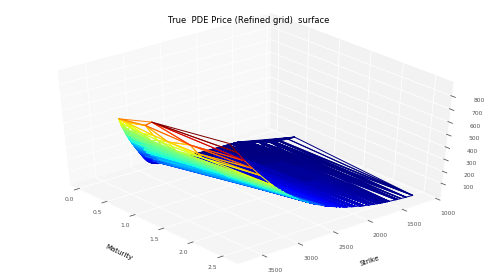

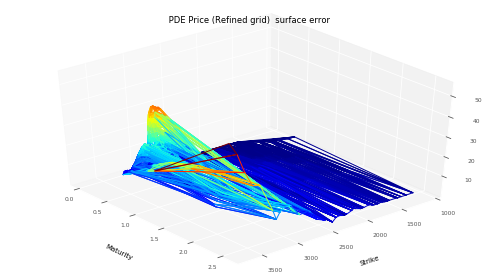

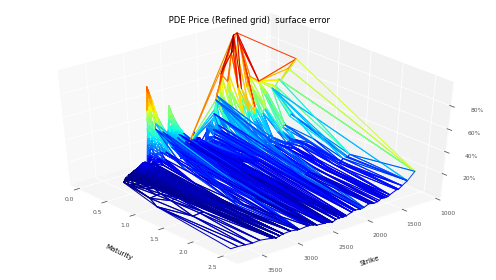

RMSE :  10.328487862754614
RMSE Relative:  0.25636371070243613


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


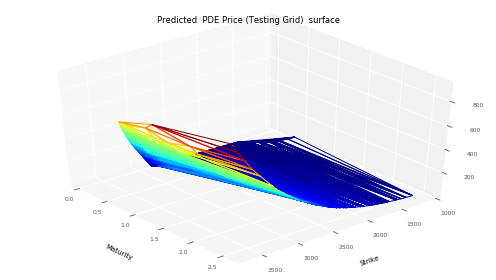

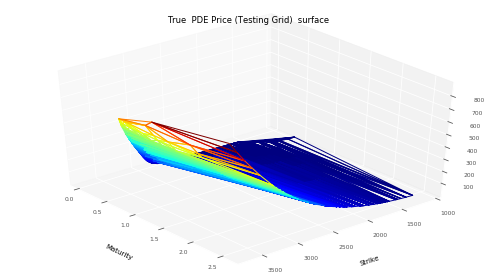

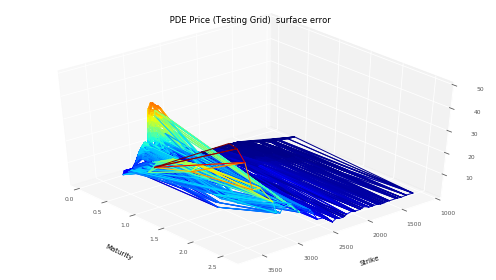

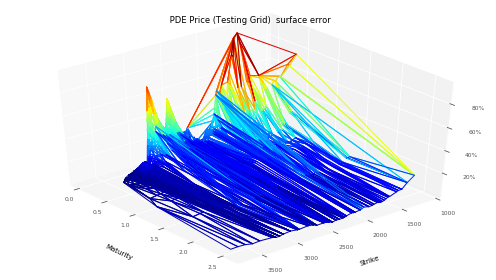

RMSE :  9.646854512155963
RMSE Relative:  0.2603044316653463


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [12]:
resBacktest = experiments.backTestLocalVolatility(neuralVolLocaleGatheral, 
                                                  volLocaleGridDf,
                                                  dataSetTest,
                                                  nbTimeStep,
                                                  nbPaths,
                                                  KMin,
                                                  KMax,
                                                  S0,
                                                  bootstrap,
                                                  "NeuralImpliedVolatility")
volLocalGridRefinedG, volLocalGridTestG, mcResVolLocaleRefinedG, mcResVolLocaleTestG, pdeResVolLocaleRefinedG, pdeResVolLocaleTestG = resBacktest

#### NN: Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [13]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 5.0 * 1e0#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1e4#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 1e7#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.000001#0.01
hyperparameters["lowerBoundGamma"] = 0.0000001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 1.00

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 10000
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = False
hyperparameters["nbEpochFork"] = 0#10000
hyperparameters["lambdaFork"] = 0.0#1000.0
hyperparameters["HolderExponent"] =  2.0

In [14]:
importlib.reload(plotTools)
importlib.reload(neuralNetwork)

<module 'neuralNetwork' from './code/neuralNetwork.py'>

/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Training w.r.t. price RMSE and arbitrage constraints
Epoch :  3038
False
True
True
False
False
False
True
False
Iteration :  3038 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 3039): 2.61
Best Penalization :  [13.501333, 0.0, [0.0, 0.009166694, 0.5080134]]
Best Penalization (Refined Grid) :  [[0.0, 0.0044365125, 0.041595556]]
Epoch :  5582
False
True
True
False
False
False
True
False
Iteration :  5582 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 5583): 2.50
Best Penalization :  [12.050732, 0.0, [0.0, 0.0, 1.7355453]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.15542951]]
Epoch :  6099
False
True
True
False
False
False
True
False
Iteration :  6099 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 6100): 2.50
Best Penalization :  [12.050732, 0.0, [0.0, 0.0, 1.7355453]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.15542951]]
Epoch :  7302
False
True
True
False
False
False
True
False
Iteration :  7302 new learnin

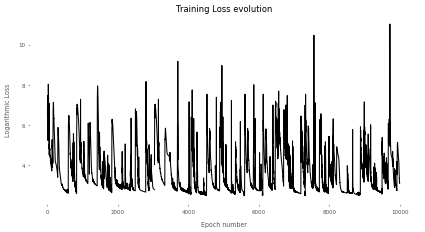

In [15]:
res = experiments.trainNeuralNetworkPrice(dataSet, 
                                          hyperparameters,
                                          scaler, 
                                          True)
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): 2.50
Best Penalization :  [12.050732, 0.0, [0.0, 0.0, 1.7355453]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.15542951]]
Refined Grid evaluation :
Number of arbitrage violation :  0
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


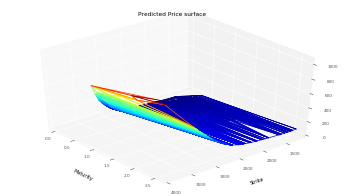

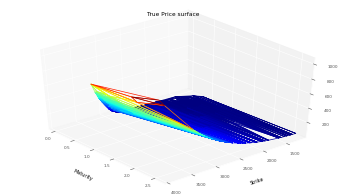

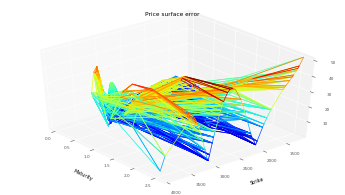

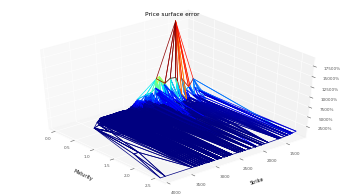

RMSE :  12.050731665124177
RMSE Relative:  7.583387446248586


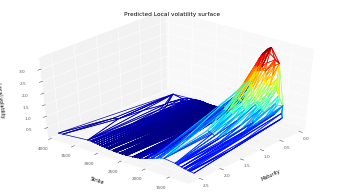

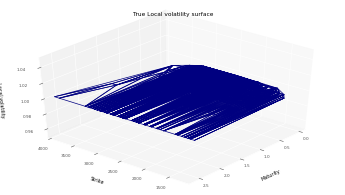

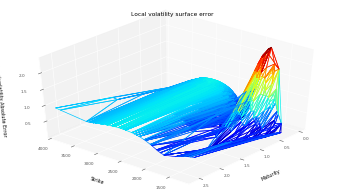

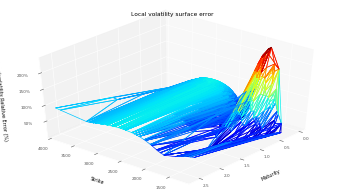

RMSE :  0.8103761284805584
RMSE Relative:  0.8103761284805584


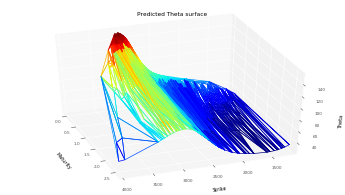

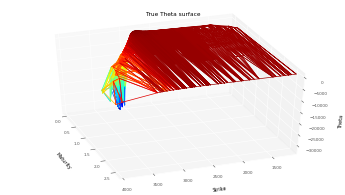

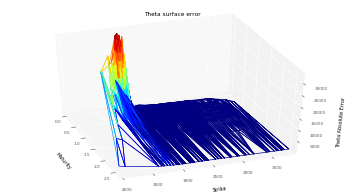

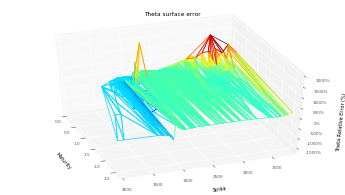

RMSE :  5870.608406349705
RMSE Relative:  1.5505495208911713


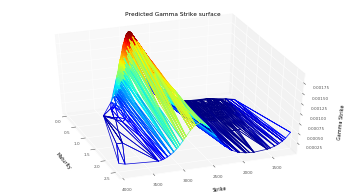

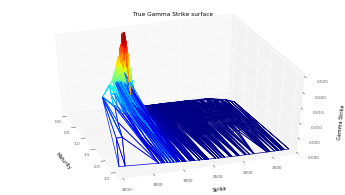

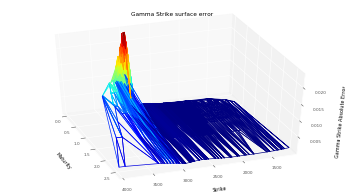

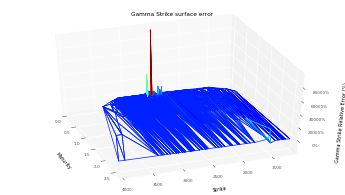

RMSE :  0.005632421634830429
RMSE Relative:  27.66046049717956


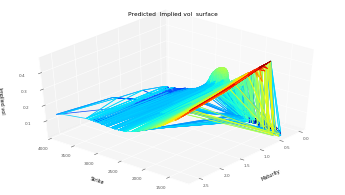

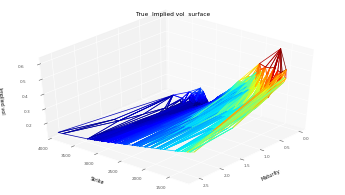

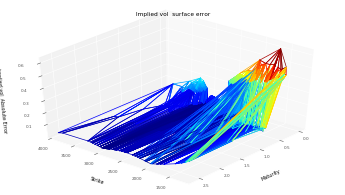

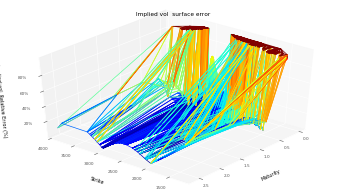

RMSE :  0.1459660423526969
RMSE Relative:  0.5151474999376213
ATM Local Vol :
Strike  Maturity
2860.0  0.055       0.129149
        0.074       0.128524
        0.082       0.128270
        0.093       0.127962
        0.370       0.121516
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): 2.50
Best Penalization :  [12.022673, 0.0, [0.0, 0.0, 1.9992025]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.15542951]]
Refined Grid evaluation :
Number of arbitrage violation :  0
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


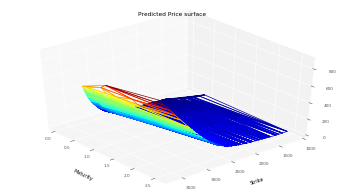

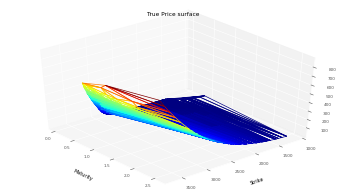

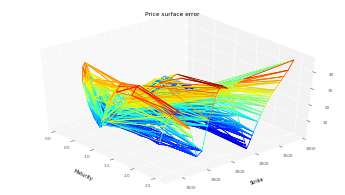

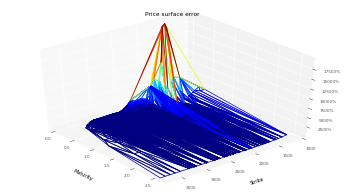

RMSE :  12.02267136976492
RMSE Relative:  11.08031328900666


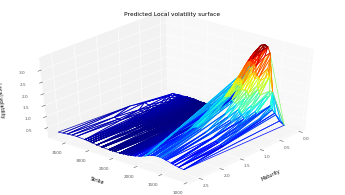

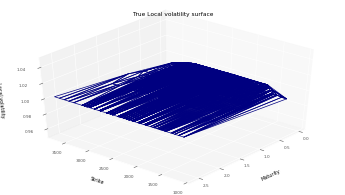

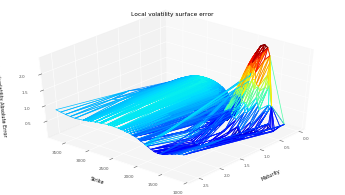

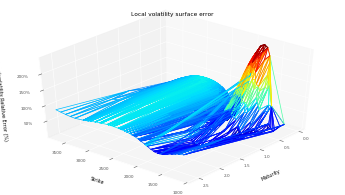

RMSE :  0.8279361362463741
RMSE Relative:  0.8279361362463741


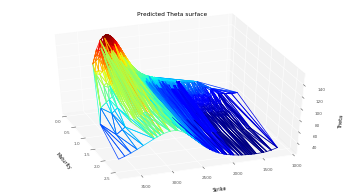

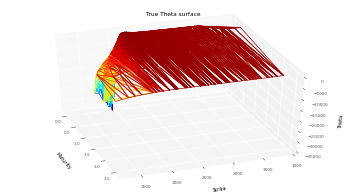

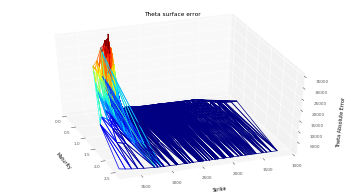

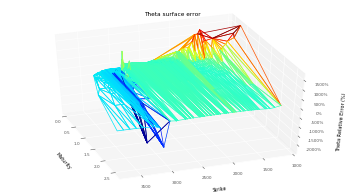

RMSE :  5814.332434863103
RMSE Relative:  1.7521798859096263


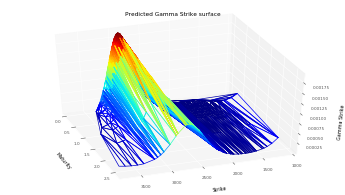

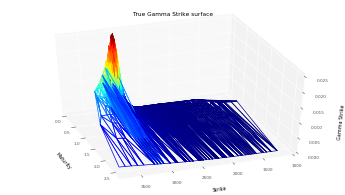

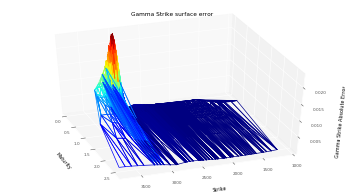

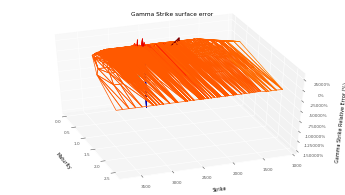

RMSE :  0.005336537312822393
RMSE Relative:  45.9537971090054


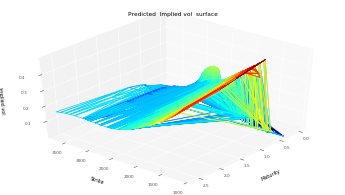

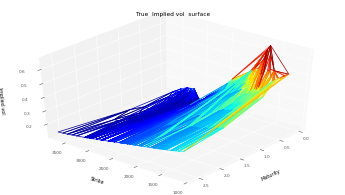

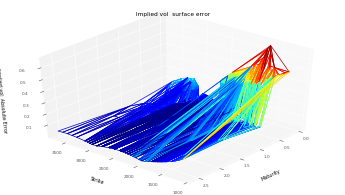

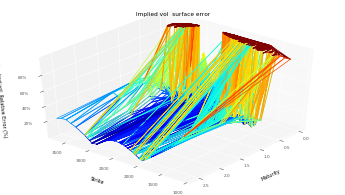

RMSE :  0.14999885872351398
RMSE Relative:  0.5102444558037628


In [16]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableFreePrice(dataSet, 
                                                                         dataSetTest,
                                                                         hyperparameters,
                                                                         scaler,
                                                                         KMin,
                                                                         KMax,
                                                                         S0, midS0,
                                                                         bootstrap)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ d\log{S_t}  = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ d\log{S_t}  = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

In [17]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "convexSoftVolModel")
    return vLoc.dropna()

In [18]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


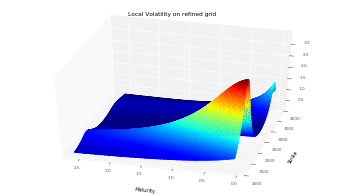

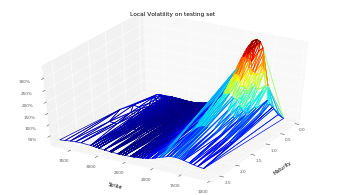

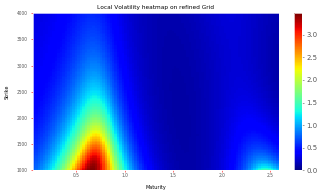

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


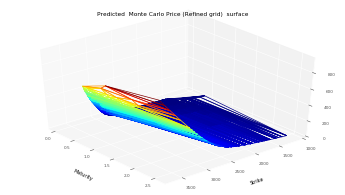

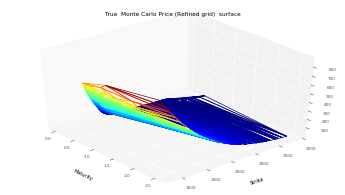

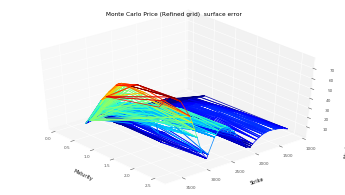

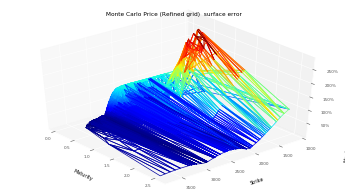

RMSE :  12.979517554623316
RMSE Relative:  0.6639074221450729


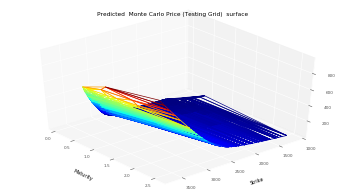

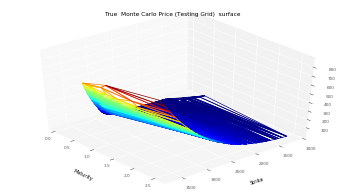

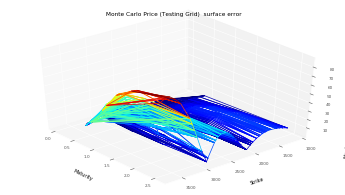

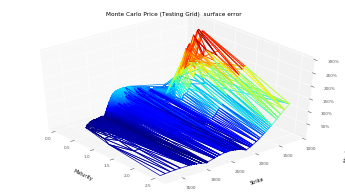

RMSE :  12.625020123777388
RMSE Relative:  0.6279177051697994
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


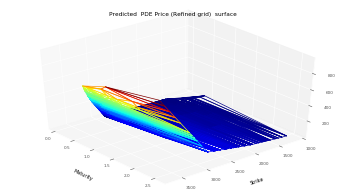

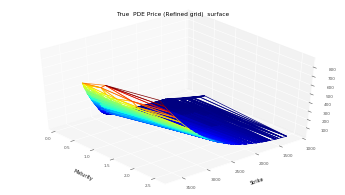

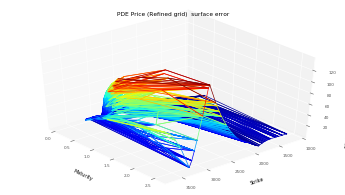

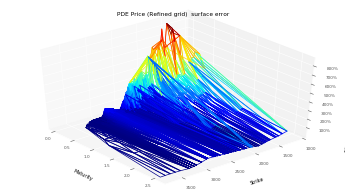

RMSE :  24.66954785844787
RMSE Relative:  1.3338384959500358


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


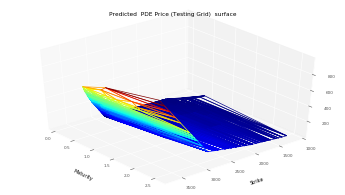

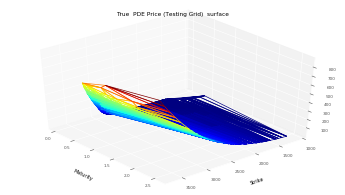

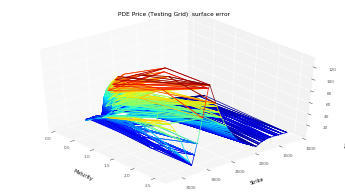

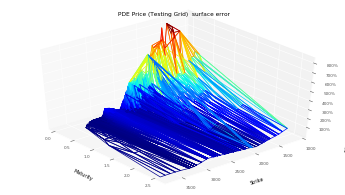

RMSE :  24.534461549902794
RMSE Relative:  1.3251960261527718


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [19]:
resBacktest = experiments.backTestLocalVolatility(neuralVolLocalePrix, 
                                                  volLocaleGridDf,
                                                  dataSetTest,
                                                  nbTimeStep,
                                                  nbPaths,
                                                  KMin,
                                                  KMax,
                                                  S0,
                                                  bootstrap,
                                                  "NeuralPrice")
volLocalGridRefined, volLocalGridTest, mcResVolLocaleRefined, mcResVolLocaleTest, pdeResVolLocaleRefined, pdeResVolLocaleTest = resBacktest

## SSVI Unconstrained

#### Run SSVI Model

Implementation is inspired from Tahar Ferhati code : 
- Ferhati, T. (2020). Robust Calibration For SVI Model Arbitrage Free. Available at SSRN 3543766.

In [20]:
ssviModel = experiments.trainSSVIModel(dataSet, S0, bootstrap, False)

time step 0  :  0.055
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.0011353325069916058
            Iterations: 53
            Function evaluations: 387
            Gradient evaluations: 53
time step 1  :  0.063
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.00028893487856237804
            Iterations: 19
            Function evaluations: 145
            Gradient evaluations: 19
time step 2  :  0.068
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.0009360564464254988
            Iterations: 24
            Function evaluations: 177
            Gradient evaluations: 24
time step 3  :  0.07400000000000001
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.003718999014387667
            Iterations: 30
            Function evaluations: 223
            Gradient evaluations: 30
time step 4  :  0.08199999999999999
Op

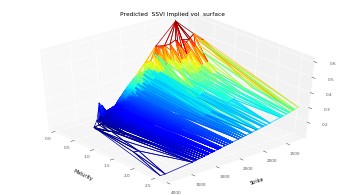

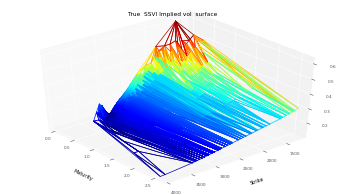

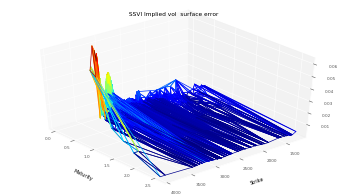

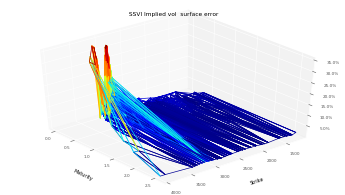

RMSE :  0.010368377980569329
RMSE Relative:  0.07592905029347828


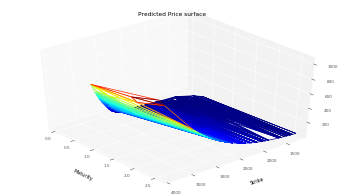

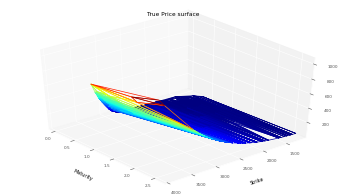

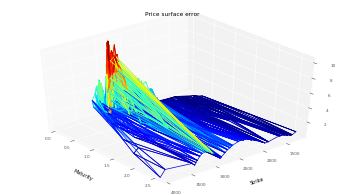

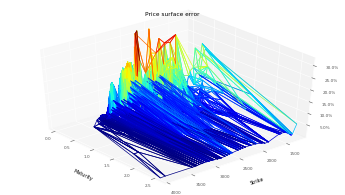

RMSE :  2.690792594341126
RMSE Relative:  0.08026336196113741


./code/SSVIFerhati.py:746: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


Number of arbitrage violations :  175
Arbitrable volatility :  Strike  Maturity
1325.0  0.621       0.392601
1350.0  0.621       0.386511
1400.0  0.841       0.343174
1425.0  0.621       0.369398
        0.841       0.339092
1450.0  0.621       0.364428
1475.0  0.841       0.330356
1500.0  0.621       0.353988
1525.0  0.621       0.349126
1575.0  0.621       0.339872
        0.841       0.315210
1650.0  0.621       0.325103
        0.841       0.302510
1675.0  0.841       0.300679
1700.0  0.131       0.494278
        0.841       0.297572
1725.0  0.841       0.294571
1750.0  0.621       0.308134
1775.0  0.621       0.304199
        0.841       0.287759
1800.0  0.621       0.300013
        0.841       0.284331
1825.0  0.841       0.281265
1875.0  0.621       0.288326
1900.0  0.131       0.425823
        0.621       0.284459
1975.0  0.621       0.273649
        0.841       0.262794
2000.0  0.131       0.391238
        0.621       0.269981
                      ...   
3035.0  0.131       0

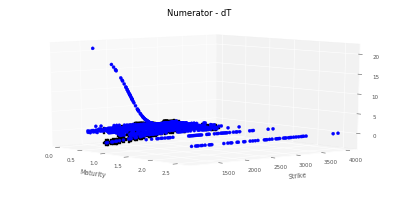

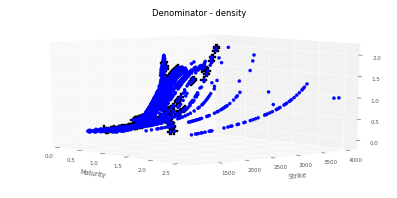

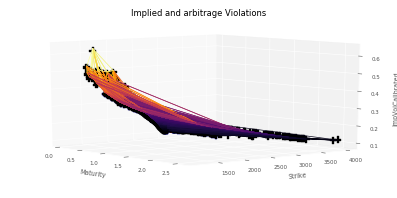

/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


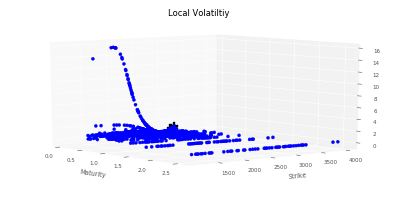

In [21]:
serie, dT, hk, dK, locVolSSVI, density = experiments.evalSSVIModel(dataSet, 
                                                                   ssviModel, 
                                                                   KMin, KMax, 
                                                                   S0,
                                                                   bootstrap, 
                                                                   "SSVIUnconstrainedTraining")


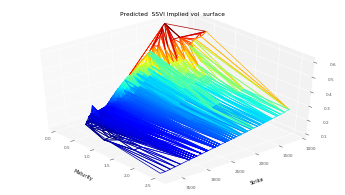

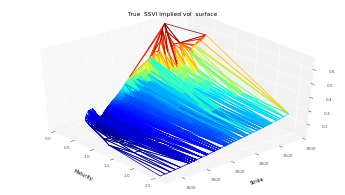

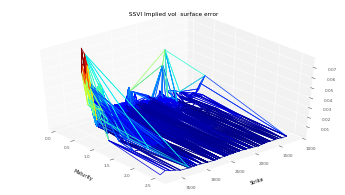

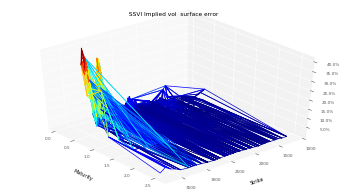

RMSE :  0.010901127390151994
RMSE Relative:  0.0767375599944245


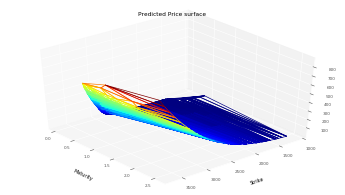

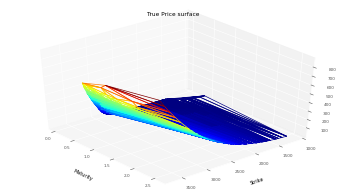

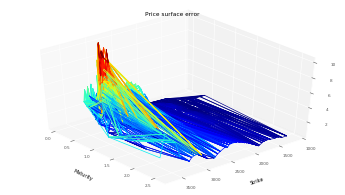

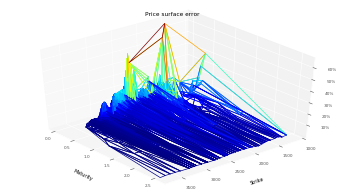

RMSE :  2.7906917627708636
RMSE Relative:  0.09067979628487602


./code/SSVIFerhati.py:746: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


Number of arbitrage violations :  177
Arbitrable volatility :  Strike  Maturity
1275.0  0.621       0.404517
1300.0  0.621       0.398610
1375.0  0.621       0.380357
1400.0  0.621       0.374944
1450.0  0.841       0.334808
1475.0  0.621       0.358645
1500.0  0.841       0.326848
1525.0  0.841       0.322745
1550.0  0.621       0.344093
        0.841       0.319092
1600.0  0.621       0.334517
        0.841       0.311134
1625.0  0.621       0.329902
        0.841       0.307906
1675.0  0.621       0.320874
1700.0  0.621       0.316420
1725.0  0.621       0.311772
1750.0  0.131       0.478358
        0.841       0.290933
1800.0  0.131       0.460873
1825.0  0.621       0.296080
1850.0  0.131       0.442365
        0.621       0.291900
        0.841       0.278208
1875.0  0.841       0.275145
1900.0  0.841       0.271822
1925.0  0.621       0.281051
        0.841       0.268723
1950.0  0.131       0.408037
        0.621       0.277331
                      ...   
3050.0  0.063       0

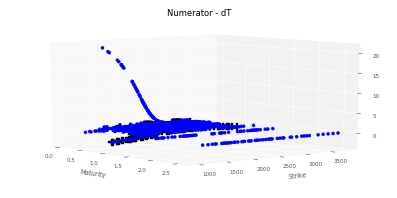

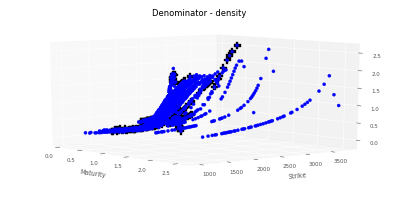

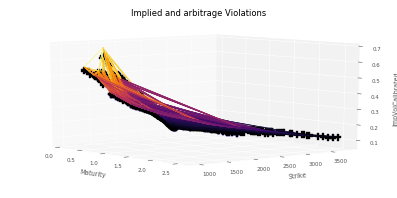

/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


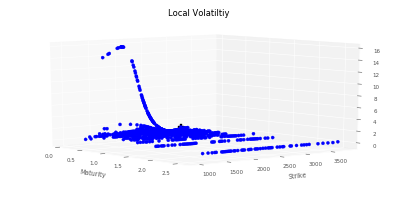

In [22]:
serieTest, dTTest, hkTest, dKTest, locVolSSVITest, densityTest = experiments.evalSSVIModel(dataSetTest, 
                                                                                           ssviModel, 
                                                                                           KMin, KMax, 
                                                                                           S0,
                                                                                           bootstrap, 
                                                                                           "SSVIUnconstrainedTesting")

## SSVI Backtesting

#### Run SSVI Model

Implementation is inspired from Matlab code of Philipp Rindler : 
- Philipp Rindler (2020). Gatherals and Jacquier's Arbitrage-Free SVI Volatility Surfaces (https://www.mathworks.com/matlabcentral/fileexchange/49962-gatherals-and-jacquier-s-arbitrage-free-svi-volatility-surfaces), MATLAB Central File Exchange. Retrieved November 20, 2020.

In [23]:
ssviModel = experiments.trainSSVIModel(dataSet, S0, bootstrap, True)

Contrainte :  -0.4273863254579473
Parameters of SSVI model :  [-0.53610164  1.02376928  0.5       ]
time step 25  :  2.585

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.22923860265942486    satisfied
RMSE :  0.09624694089323861



./code/SSVI.py:680: RuntimeWarning: invalid value encountered in sqrt
  alpha = np.sign(beta) * np.sqrt(1 / beta ** 2 - 1)
./code/SSVI.py:682: RuntimeWarning: invalid value encountered in sqrt
  (b * (-rho + np.sign(alpha) * np.sqrt(1 + alpha ** 2) - alpha * np.sqrt(1 - rho ** 2))))
./code/SSVI.py:693: RuntimeWarning: invalid value encountered in sqrt
  a = vt * tau - b * sigma * np.sqrt(1 - rho ** 2)
./code/SSVI.py:311: RuntimeWarning: invalid value encountered in less
  if any(model_total_implied_variance < before_total_implied_variance) :


Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.14646770035996892    satisfied
RMSE :  0.02457771420152383
--------------------------------------------------------------------

time step 24  :  1.588

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.2328121892085555    satisfied
RMSE :  0.030747635693754133



./code/SSVI.py:316: RuntimeWarning: invalid value encountered in greater
  if any(model_total_implied_variance > after_total_implied_variance) :


Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.174311894503143    satisfied
RMSE :  0.015820326484850263
--------------------------------------------------------------------

time step 23  :  1.09

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.23445700984718043    satisfied
RMSE :  0.01310183020437854

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.1979086123357099    satisfied
RMSE :  0.008424547471876098
--------------------------------------------------------------------

time step 22  :  0.871

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.2351446622482496    satisfied
RMSE :  0.017313895405337995

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.22132997415079925    satisfied
RMSE :  0.011260685074194303
--------------------------------------------------------------------

time step 21  :  0.841

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.23523523749328978

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.2658894101549686    satisfied
RMSE :  0.0019337863943318565
--------------------------------------------------------------------

Training Time :  33.00227952003479


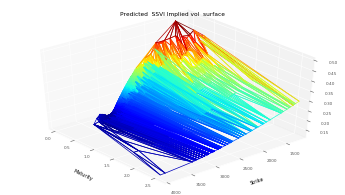

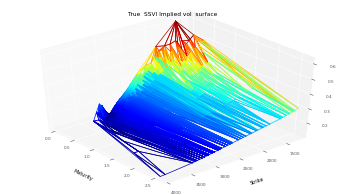

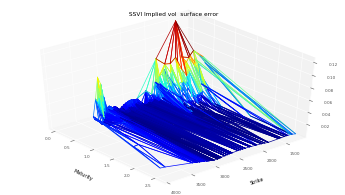

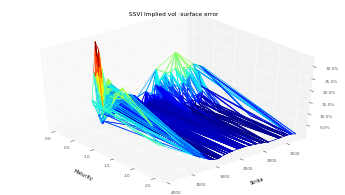

RMSE :  0.013685836997358786
RMSE Relative:  0.06547692277724594


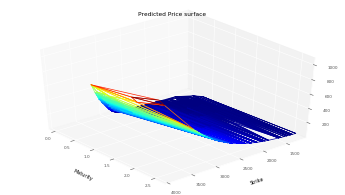

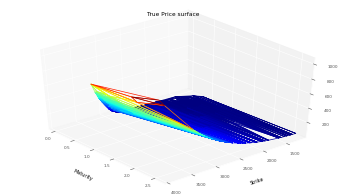

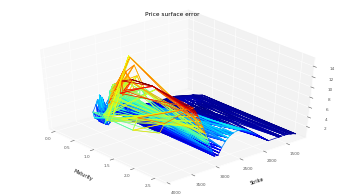

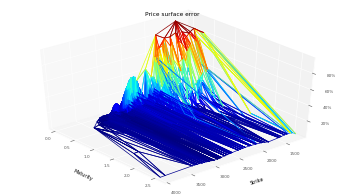

RMSE :  2.5736266214201735
RMSE Relative:  0.17007245656354983
Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpVolCalibrated, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


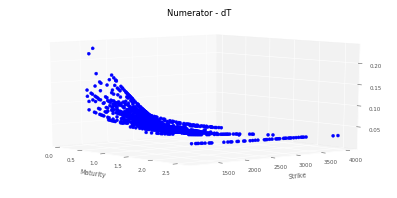

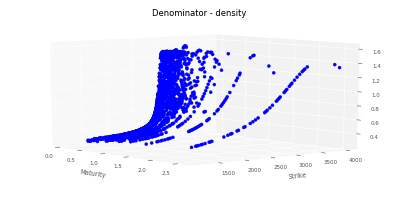

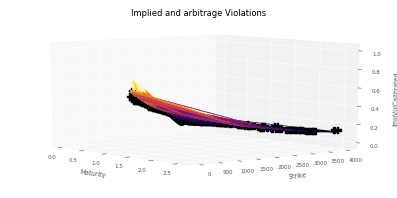

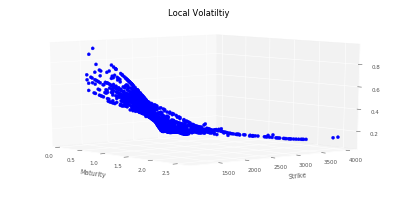

In [24]:
serie, dT, hk, dK, locVolSSVI, density = experiments.evalSSVIModel(dataSet, 
                                                                   ssviModel, 
                                                                   KMin, KMax, 
                                                                   S0,
                                                                   bootstrap, 
                                                                   "SSVIConstrainedTraining")

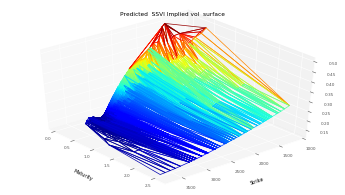

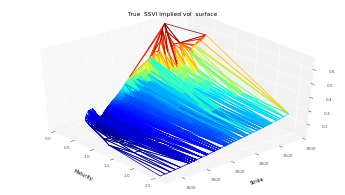

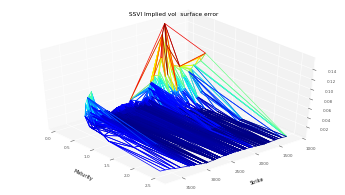

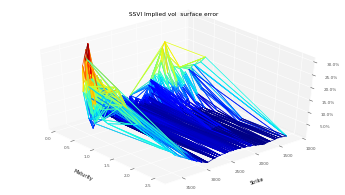

RMSE :  0.015237905219618278
RMSE Relative:  0.06890268618086454


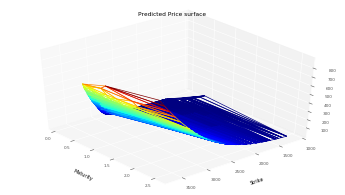

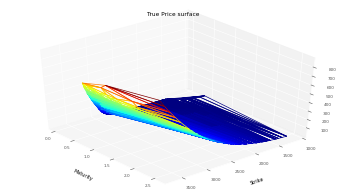

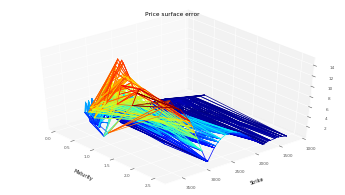

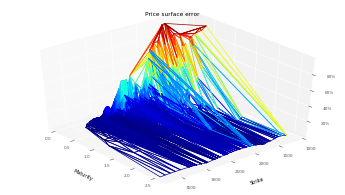

RMSE :  2.8916672631192157
RMSE Relative:  0.17810293275101263
Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpVolCalibrated, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


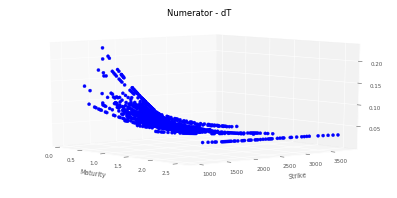

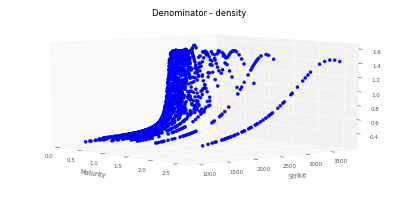

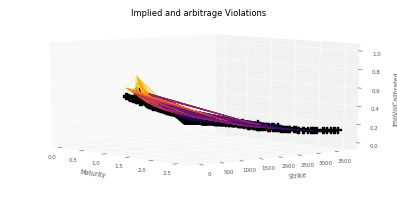

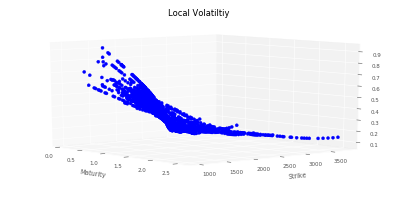

In [25]:
serieTest, dTTest, hkTest, dKTest, locVolSSVITest, densityTest = experiments.evalSSVIModel(dataSetTest, 
                                                                                           ssviModel, 
                                                                                           KMin, KMax, 
                                                                                           S0,
                                                                                           bootstrap, 
                                                                                           "SSVIConstrainedTesting")

#### Backtest Local volatility SSVI 

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [26]:
def neuralVolLocaleSSVI(s,t):
    volLocaleGrid = pd.DataFrame(np.vstack((np.ravel(s), np.ravel(t))).T, 
                                 columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
    volLocaleGrid["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGrid["Strike"], volLocaleGrid["Maturity"])[0]
    volLocaleGrid["logMoneyness"] = np.log(volLocaleGrid["ChangedStrike"] / S0)
    volLocaleGrid["OptionType"] = np.ones_like(volLocaleGrid["logMoneyness"])
    
    _, _, _, locVolSSVI, _ = SSVI.finiteDifferenceSVI(volLocaleGrid, ssviModel.eval)
    return locVolSSVI.dropna()

In [27]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


./code/SSVI.py:1169: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


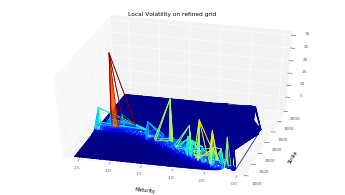

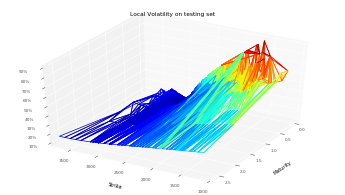

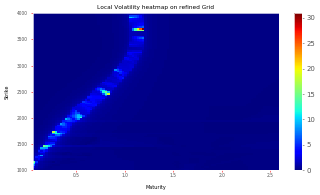

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


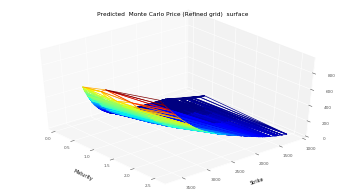

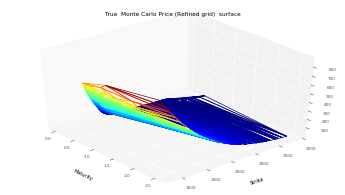

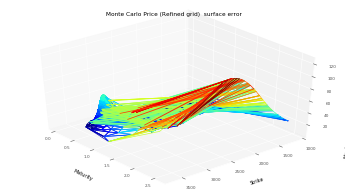

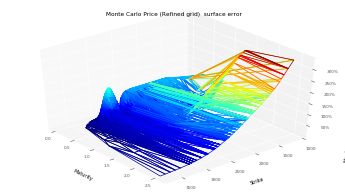

RMSE :  23.585153939825958
RMSE Relative:  0.6443281114979774


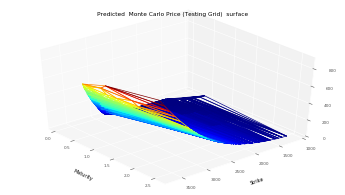

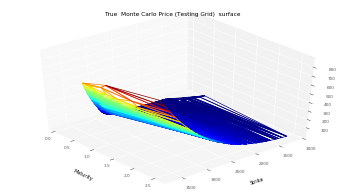

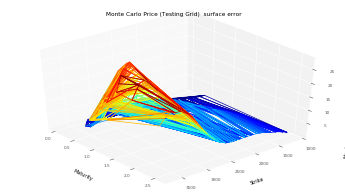

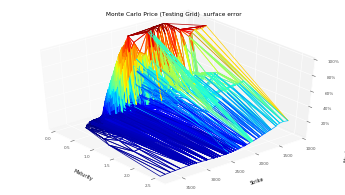

RMSE :  5.878552356230888
RMSE Relative:  0.28860033993812373
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


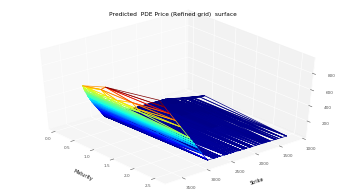

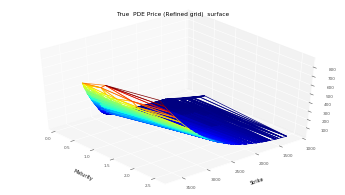

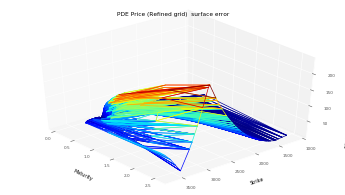

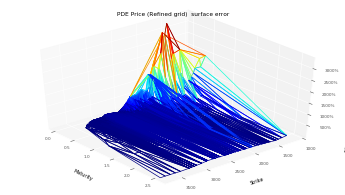

RMSE :  32.23281166886312
RMSE Relative:  2.899218361830138


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


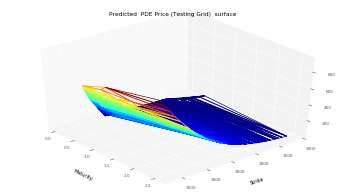

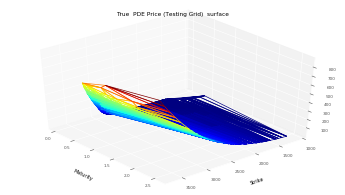

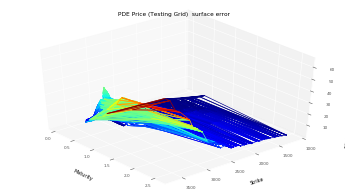

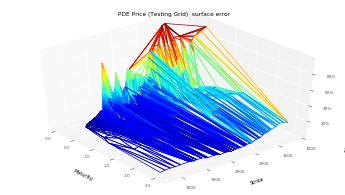

RMSE :  10.364327784418396
RMSE Relative:  0.24702430339480866


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [28]:
resBacktestSSVI = experiments.backTestLocalVolatility(neuralVolLocaleSSVI, 
                                                      volLocaleGridDf,
                                                      dataSetTest,
                                                      nbTimeStep,
                                                      nbPaths,
                                                      KMin,
                                                      KMax,
                                                      S0,
                                                      bootstrap,
                                                      "SSVI")
volLocalGridRefinedSSVI, volLocalGridTestSSVI, mcResVolLocaleRefinedSSVI, mcResVolLocaleTestSSVI, pdeResVolLocaleRefinedSSVI, pdeResVolLocaleTestSSVI = resBacktestSSVI

## GP Backtesting
The purpose of this section is to load the GP local volatility surface and perform the Monte-Carlo backtest of the option prices uses the GP local volatility surface. Note that the GP local volatility is generated by running the Matlab code in the "code/GP" folder. See Section "GP Local Volatility Backtests" below for further details of the backtests.

### Load GP Results

This section loads result from the Matlab experiments.
See code/GP folder to access the matlab script.

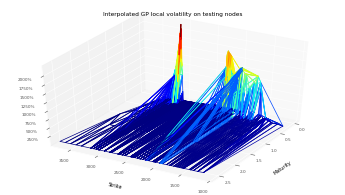

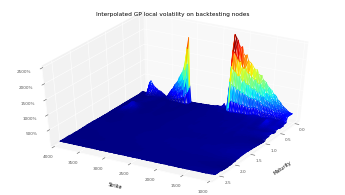

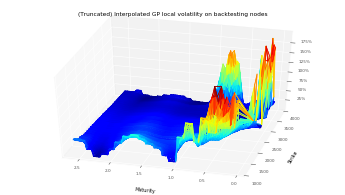

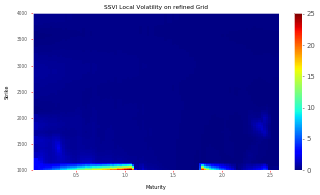

./code/experiments.py:775: RuntimeWarning: divide by zero encountered in log
  logMin = np.log(KMin/S0),


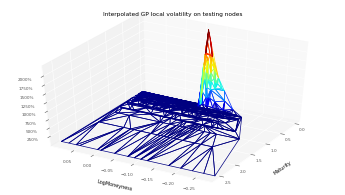

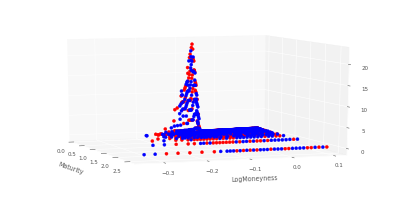

In [29]:
nnGP = experiments.loadGPResults(dataSet, dataSetTest, S0, bootstrap, KMin, KMax, volLocaleGridDf)

#### GP Local Volatility Backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ d\log{S_t} = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 

In [30]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


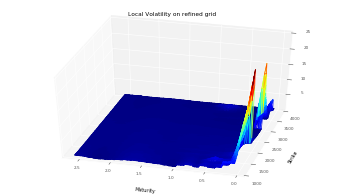

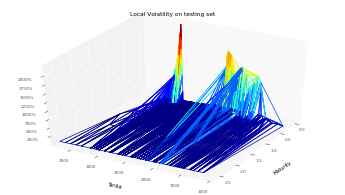

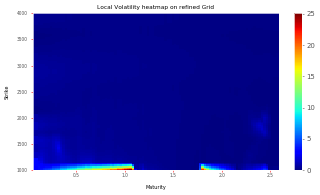

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


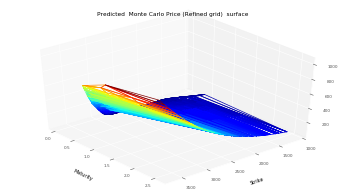

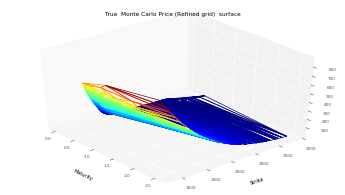

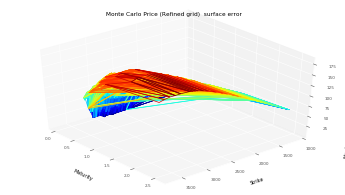

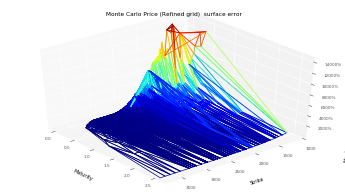

RMSE :  72.7003335451429
RMSE Relative:  17.441119895009713


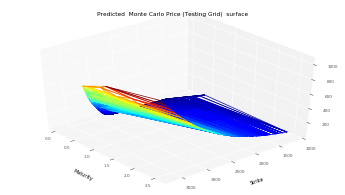

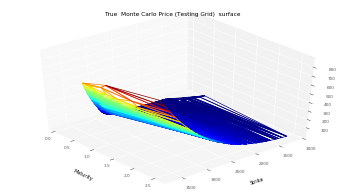

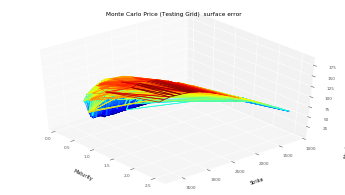

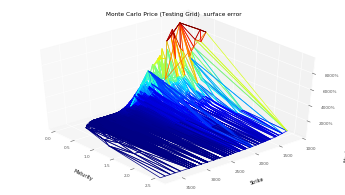

RMSE :  68.23077603935357
RMSE Relative:  12.59993927372939
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


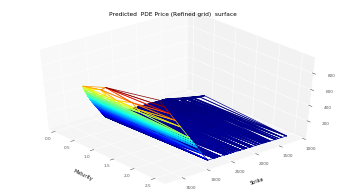

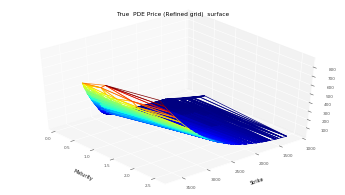

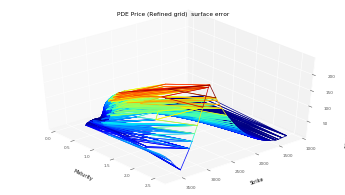

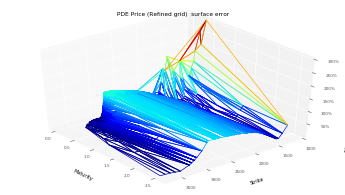

RMSE :  35.26978314020192
RMSE Relative:  0.7296470537537663


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


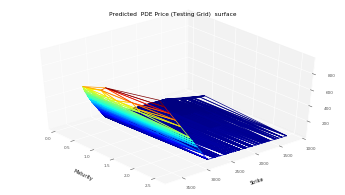

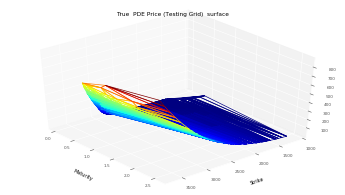

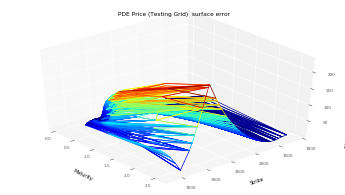

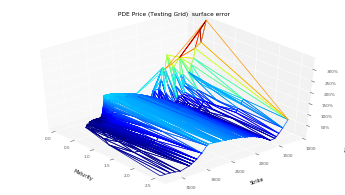

RMSE :  34.49411791539798
RMSE Relative:  0.7249979477254873


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [31]:
resBacktestGP = experiments.backTestLocalVolatility(nnGP,
                                                    volLocaleGridDf,
                                                    dataSetTest,
                                                    nbTimeStep,
                                                    nbPaths,
                                                    KMin,
                                                    KMax,
                                                    S0,
                                                    bootstrap,
                                                    "GP")
volLocalGridRefinedGP, volLocalGridTestGP, mcResVolLocaleRefinedGP, mcResVolLocaleTestGP, pdeResVolLocaleRefinedGP, pdeResVolLocaleTestGP = resBacktestGP

# Results Comparison


Loading GP results : 
Loading Neural results : 
Loading Neural results with price: 
Loading SSVI results : 
-----------------------------------------------------------------------------------------------------------------
Plotting constrained implied volatilities : 


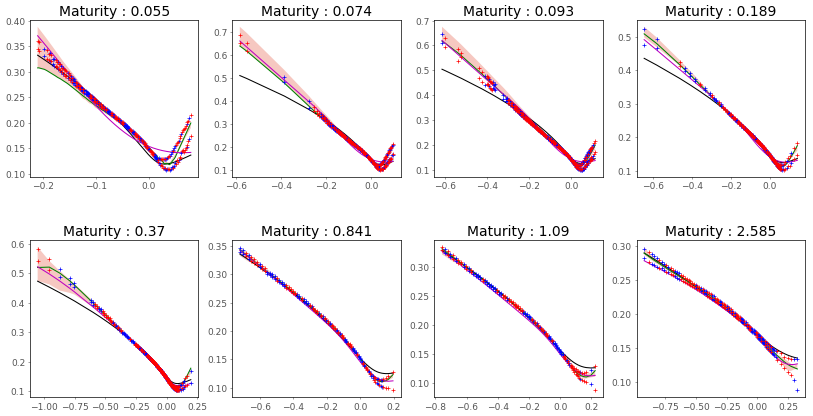

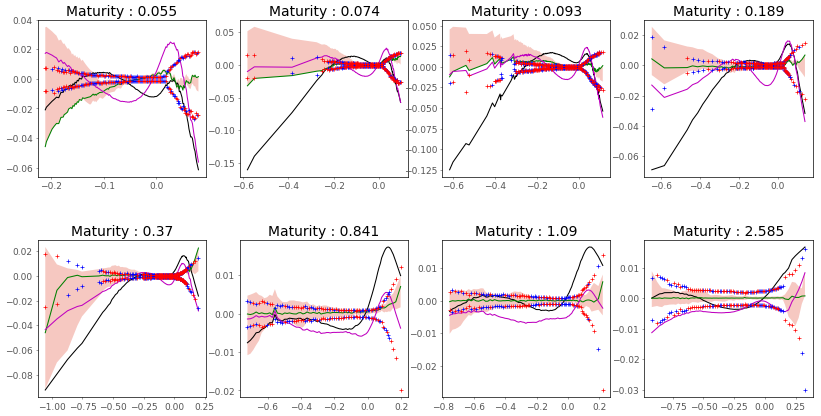

-----------------------------------------------------------------------------------------------------------------
Plotting unconstrained implied volatilities : 


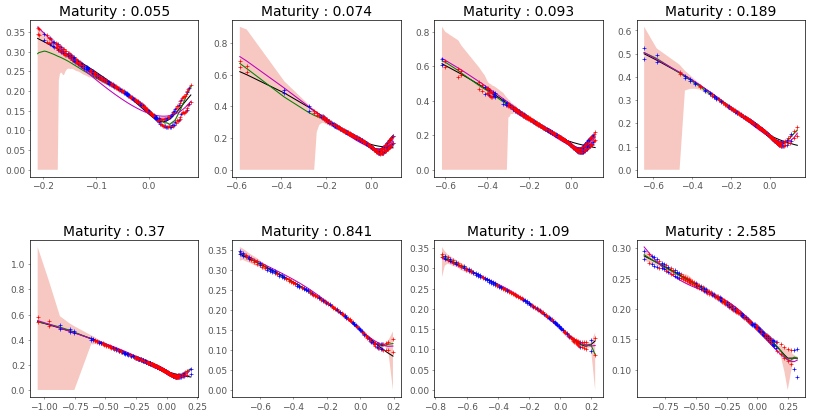

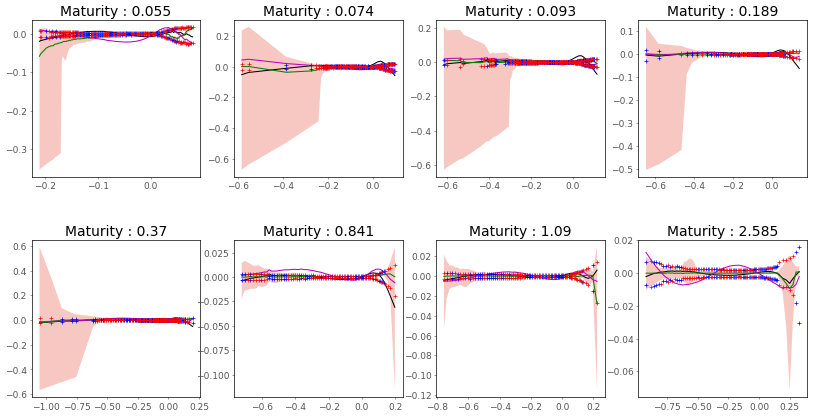

-----------------------------------------------------------------------------------------------------------------
Plotting constrained Price : 


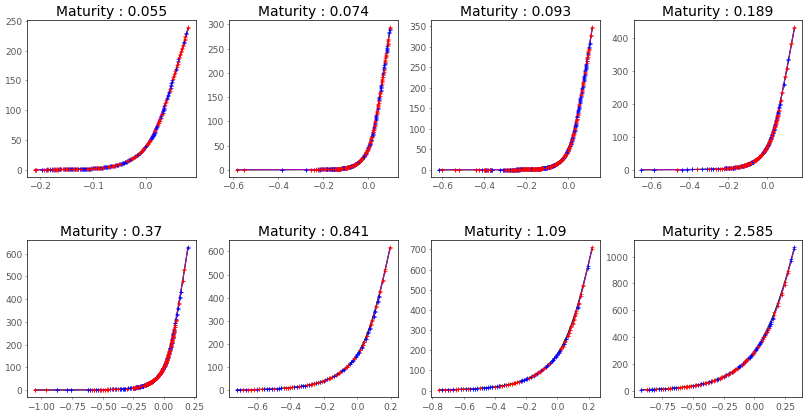

-----------------------------------------------------------------------------------------------------------------
Plotting unconstrained Price : 


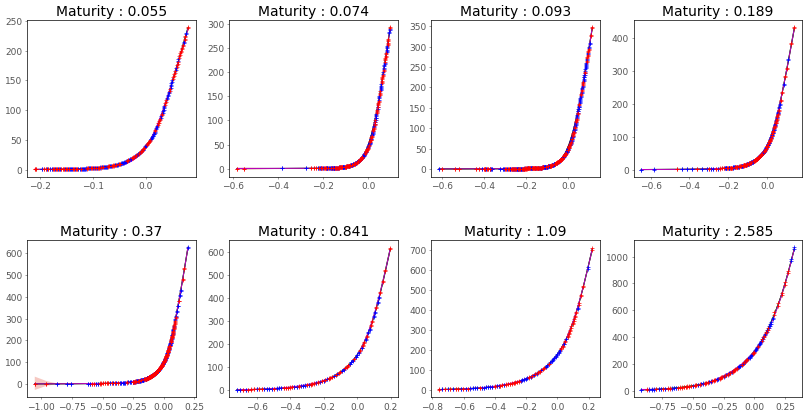

-----------------------------------------------------------------------------------------------------------------
Summarize RMSEs : 
Absolute Price RMSEs


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained
Train,2.574,0.338,2.658,12.051,2.691,0.321,2.385
Test,2.892,0.355,2.660,12.023,2.791,0.477,2.422


Relative Price RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained
Train,17.01,5.67,12.59,758.34,8.03,5.52,13.74
Test,17.81,7.00,12.93,1108.03,9.07,6.81,14.49


Absolute Implied volatility RMSEs


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained
Train,0.0137,0.0058,0.0108,0.146,0.0104,0.0060,0.0092
Test,0.0152,0.0057,0.0110,0.150,0.0109,0.0057,0.0092


Relative Implied volatility RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained
Train,6.55,4.15,6.90,51.51,7.59,4.19,5.46
Test,6.89,3.65,6.91,51.02,7.67,3.70,5.37


Absolute Price backtesting RMSEs


,SSVI,GP,Neural Network,Neural Network with price
Monte Carlo,23.585,72.70,4.246,12.98
PDE,32.233,35.27,10.328,24.67


Relative Price backtesting RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price
Monte Carlo,64.43,1744.11,41.37,66.39
PDE,289.92,72.96,25.64,133.38


In [33]:
experiments.compareResults(dataSet, dataSetTest, S0, bootstrap)

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


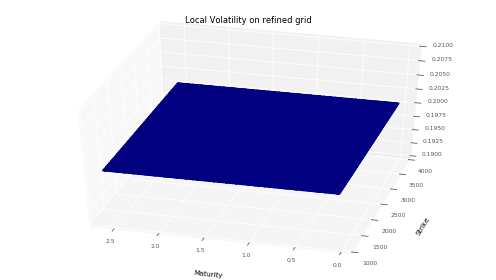

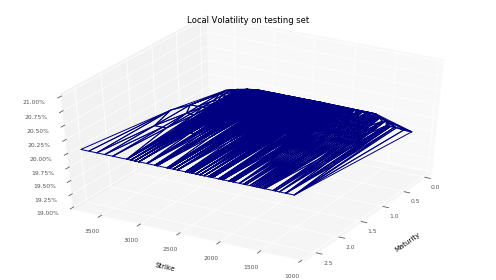

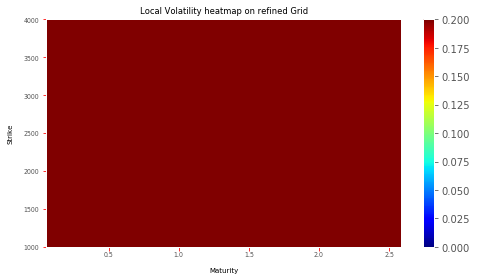

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


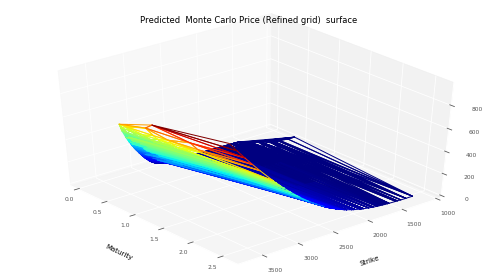

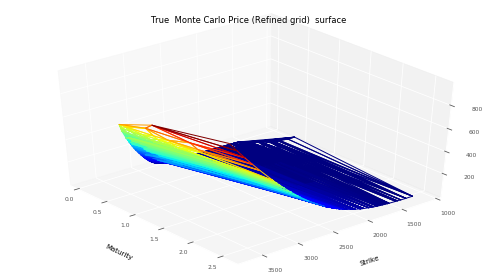

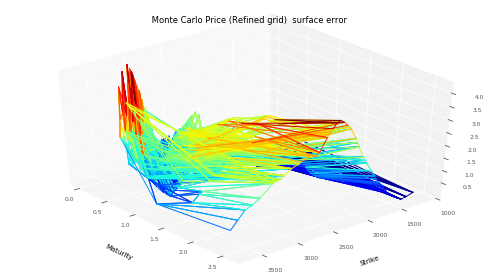

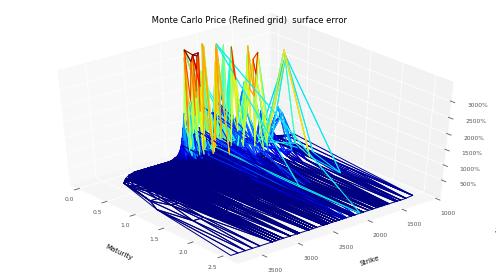

RMSE :  1.0830365471437304
RMSE Relative:  4.532257871375811


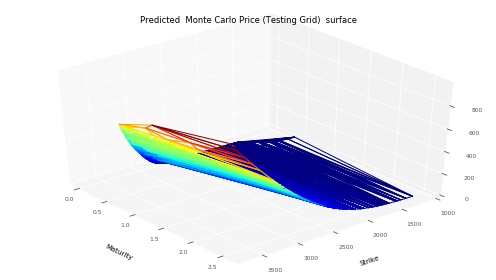

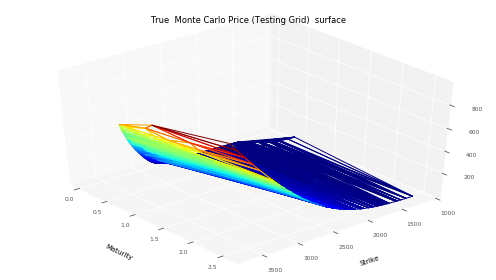

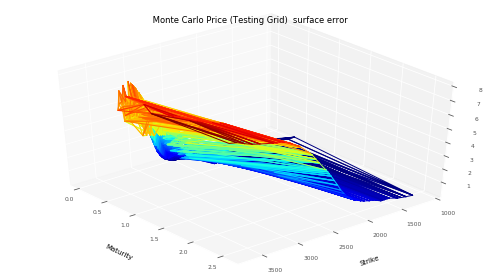

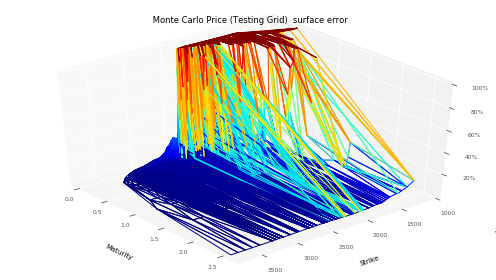

RMSE :  2.8962056439644828
RMSE Relative:  0.3408782477662023
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


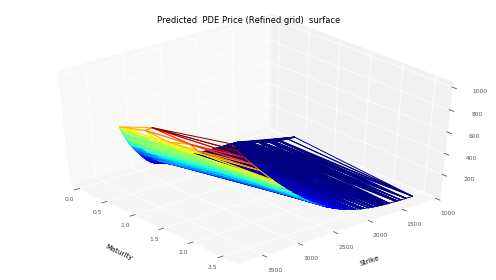

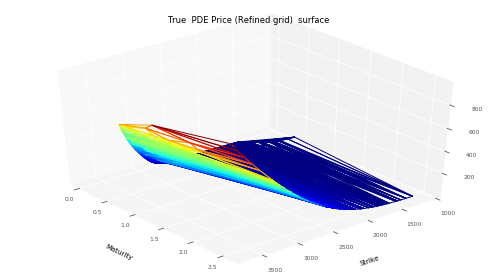

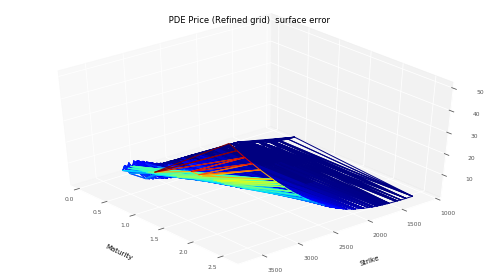

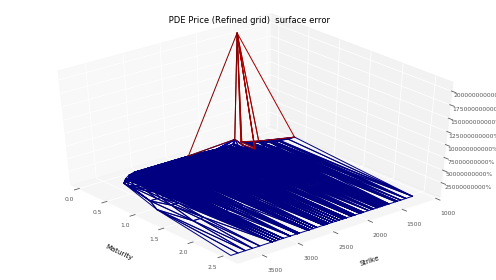

RMSE :  4.097711807278741
RMSE Relative:  50638745.83250338


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


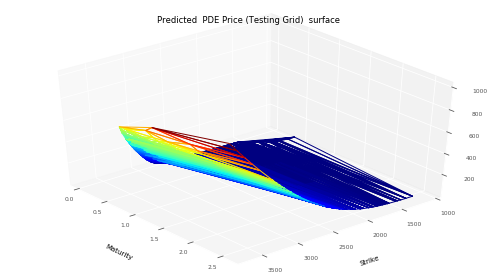

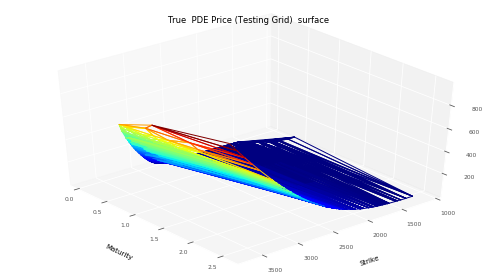

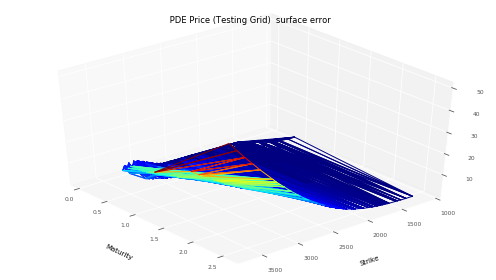

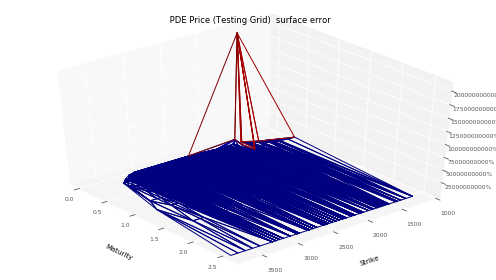

RMSE :  4.097711807278726
RMSE Relative:  50638745.83250338


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [24]:
experiments.backTestUnitTest(volLocaleGridDf,
                             dataSetTest,
                             nbTimeStep,
                             nbPaths,
                             KMin,
                             KMax,
                             S0,
                             bootstrap,
                             0.2)


In [23]:
importlib.reload(experiments)

<module 'experiments' from './code/experiments.py'>